First we load the required packages.

In [87]:

import matplotlib.pyplot as plt
from matplotlib import colormaps
import numpy as np
import pandas as pd
import seaborn as sns  
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from scipy.stats import kruskal
from sklearn.ensemble import RandomForestRegressor
from scipy.stats import pearsonr
import plotly.express as px
from sklearn.preprocessing import RobustScaler


# Analysis of species by Order


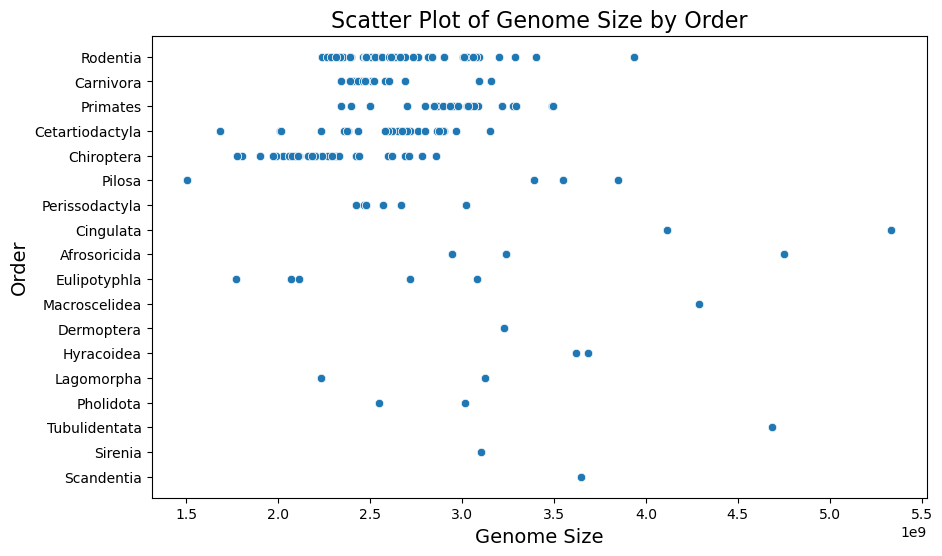

In [12]:
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')

#df = df[~df['Species_name'].str.endswith('_2')]
#df = df[df['Instrument_model'] != 'NextSeq 500']
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Genome_size', y='Order', data=df)
plt.title('Scatter Plot of Genome Size by Order', fontsize=16)
plt.xlabel('Genome Size', fontsize=14)
plt.ylabel('Order', fontsize=14)
plt.show()

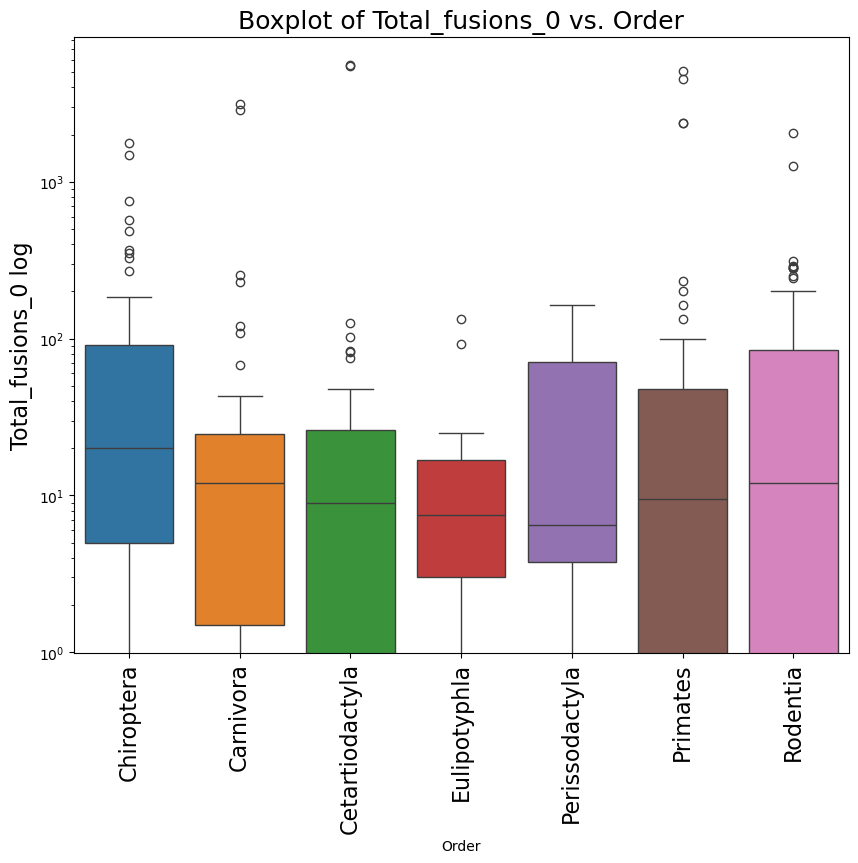

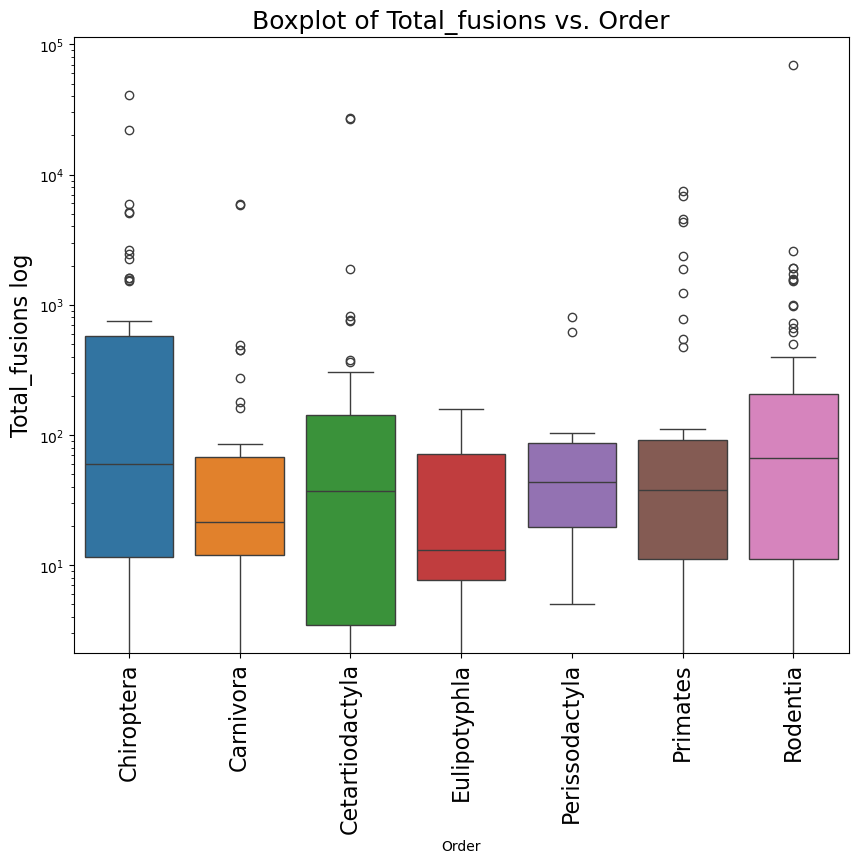

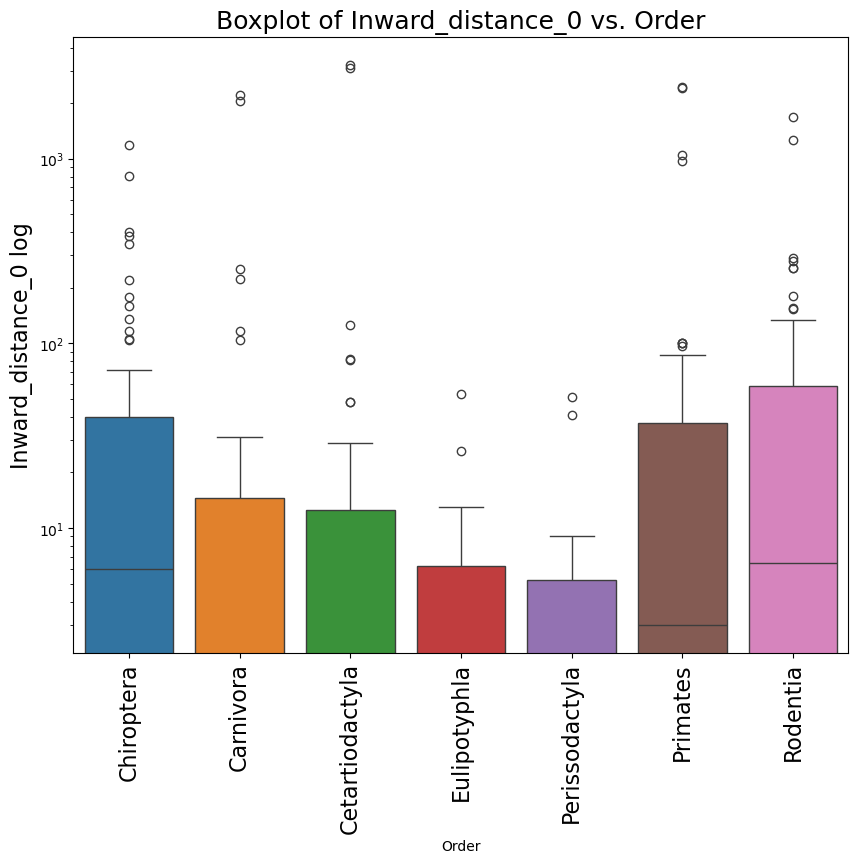

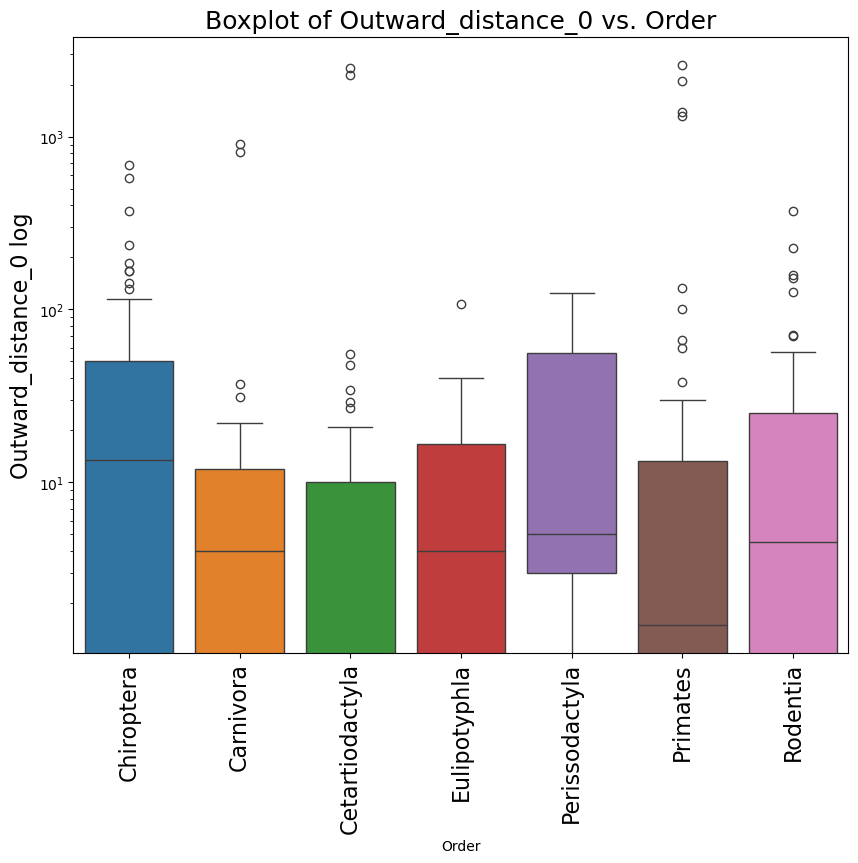

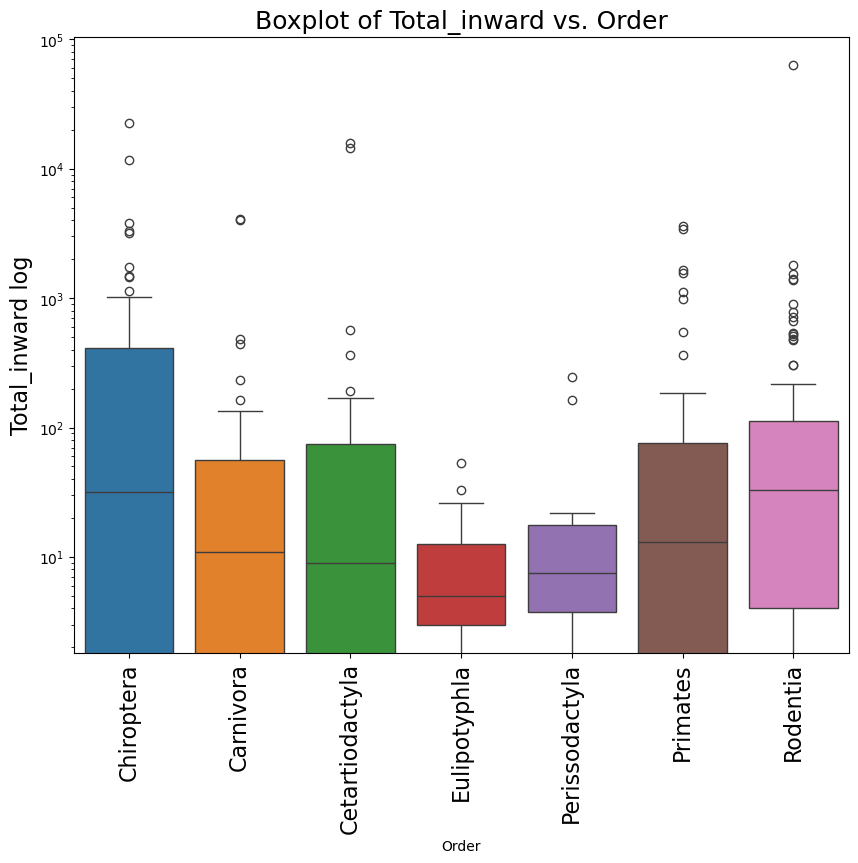

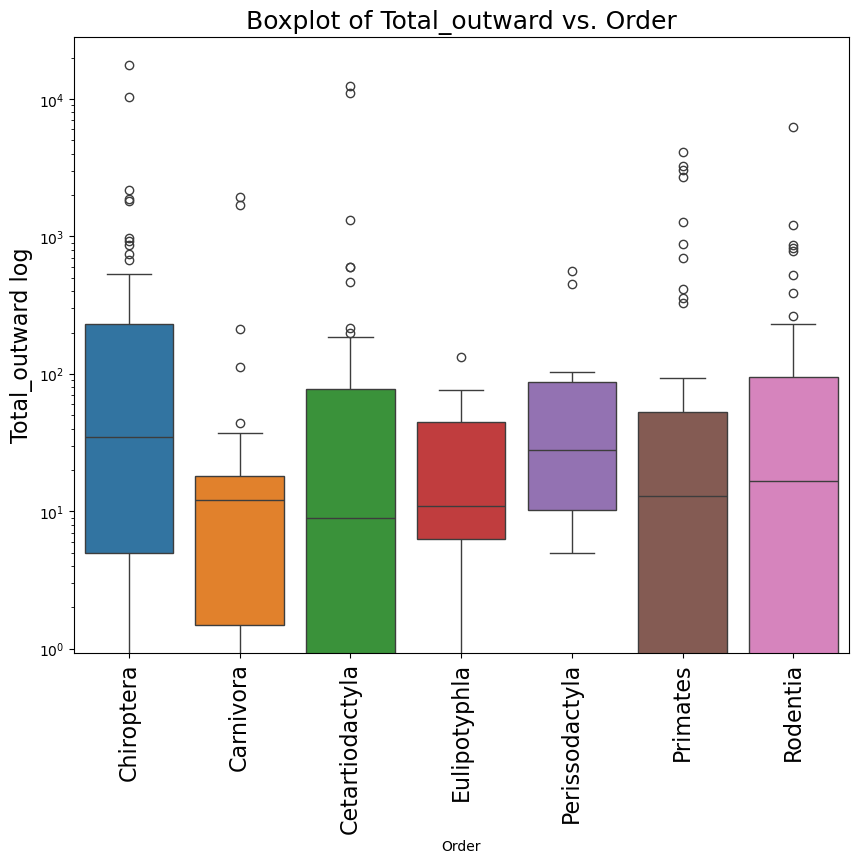

In [36]:
# Columns to analyse 
columns = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0', 'Total_inward', 'Total_outward']

for column in columns:
    df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
    df = df[[column, 'Order']]
    
    # Filter to include only 'Order' groups with at least 10 samples
    df = df.groupby('Order').filter(lambda x: len(x) >= 10)
    
    plt.figure(figsize=(10, 8))
    sns.boxplot(x='Order', y=column, data=df, hue='Order', palette='tab10')

    plt.xlabel('Order')
    plt.xticks(rotation=90, fontsize=16)
    plt.ylabel(f'{column} log', fontsize=16)
    plt.title(f'Boxplot of {column} vs. Order', fontsize=18)
    
    # Use a logarithmic scale for the y-axis
    plt.yscale('log')

    plt.show()

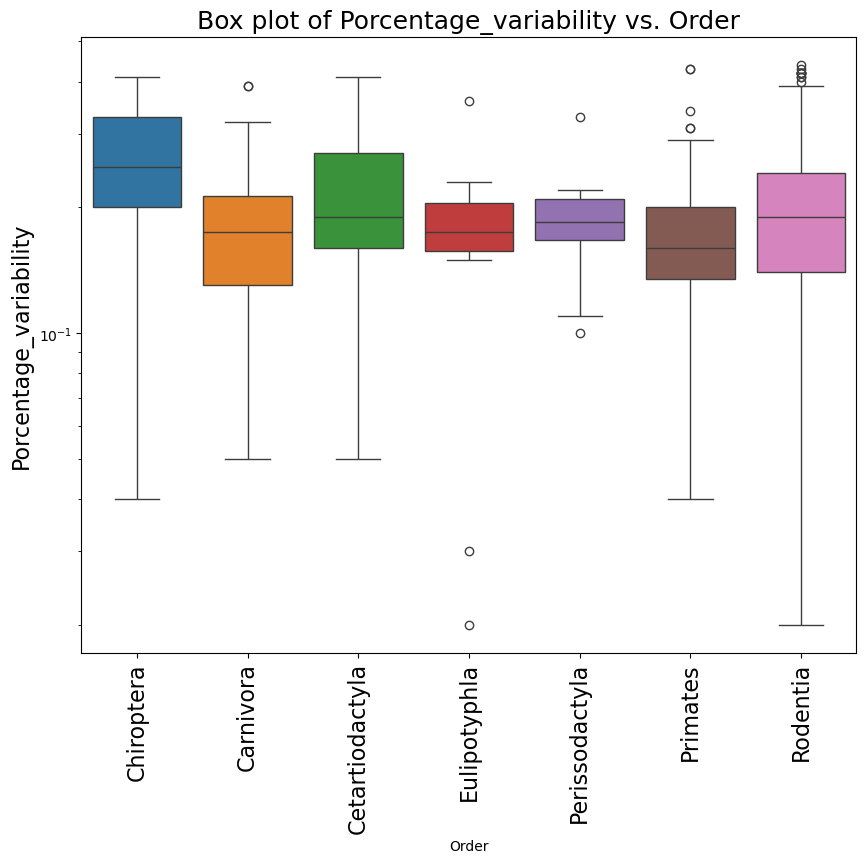

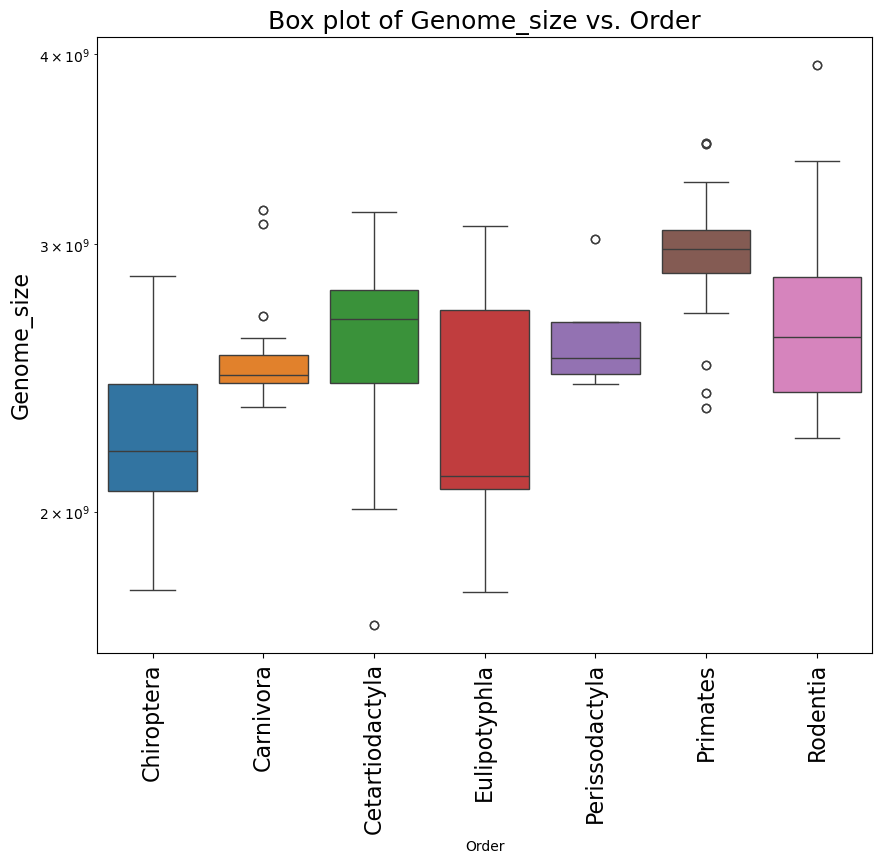

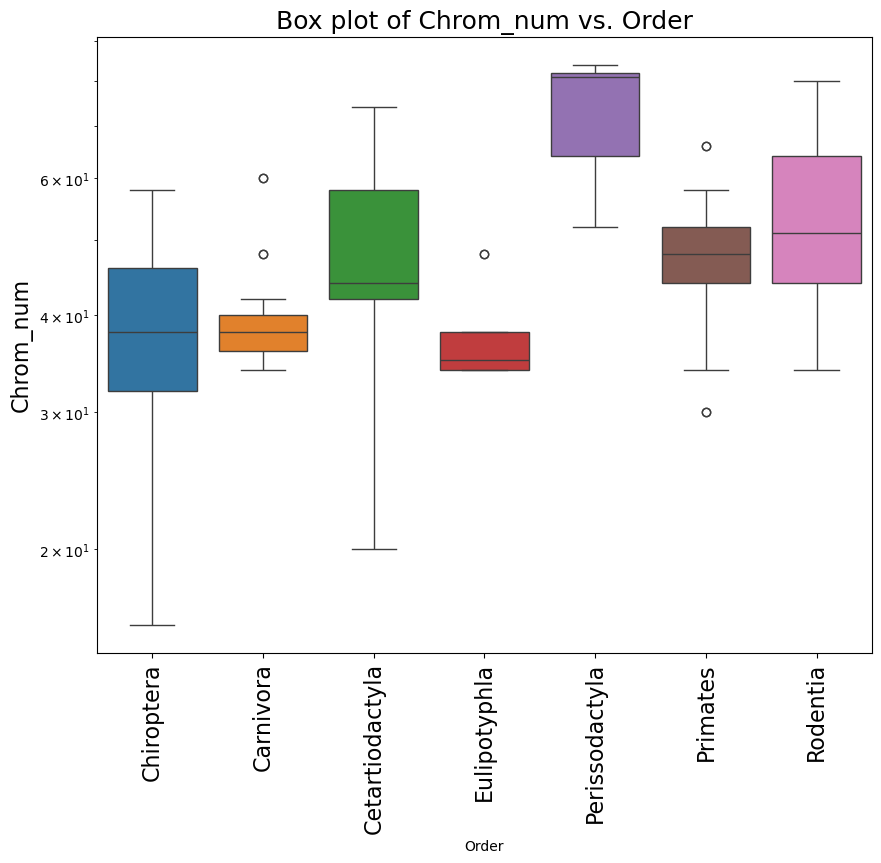

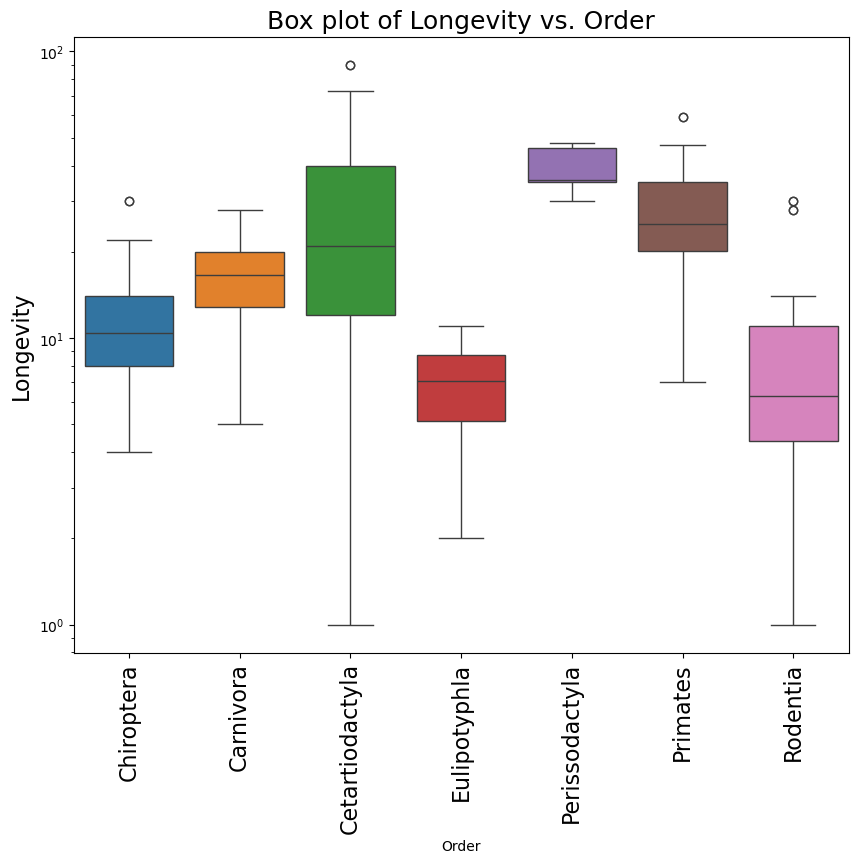

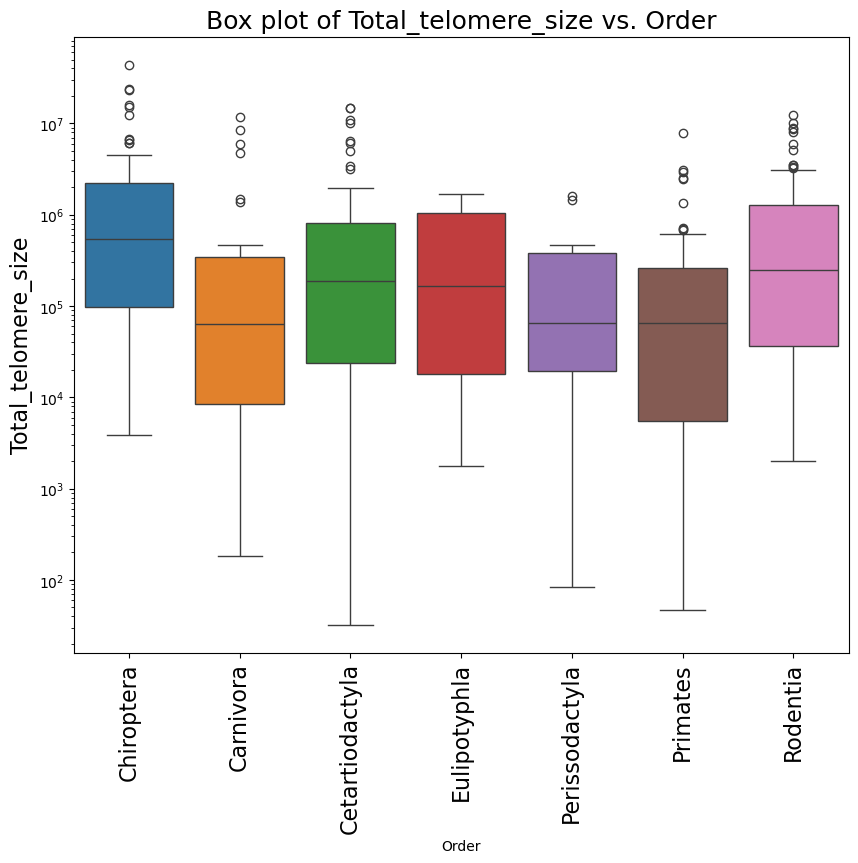

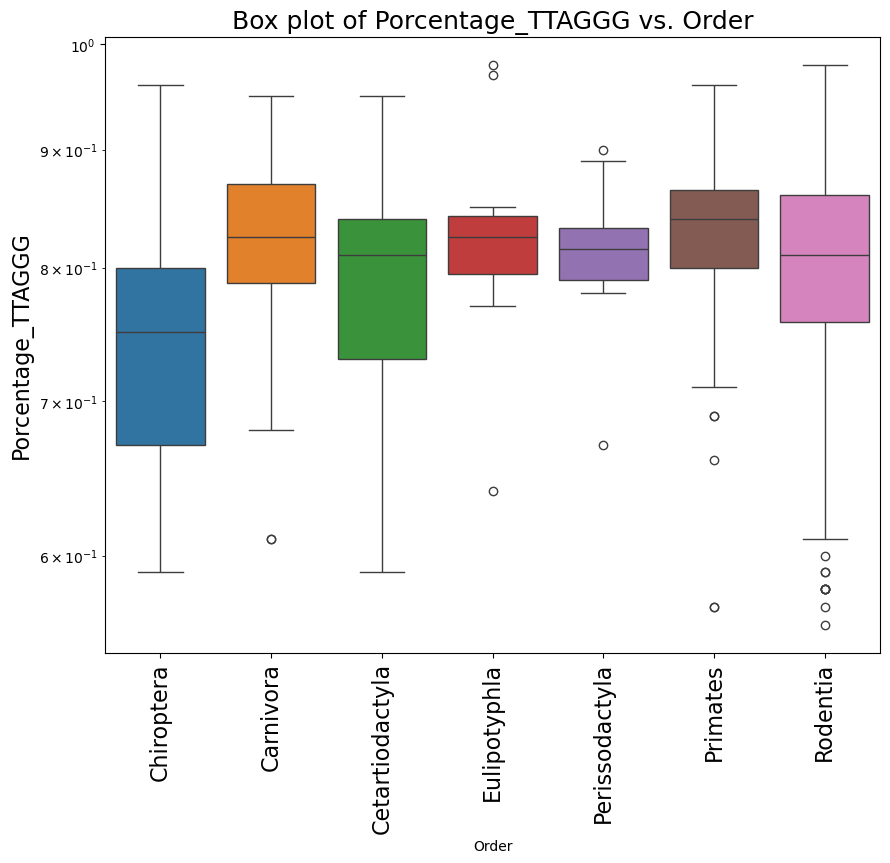

In [38]:
# Columns to analyse 
columns = ['Porcentage_variability', 'Genome_size' ,'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:
    df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')


    df = df[[column, 'Order']]
    # Filter to include only 'Order' groups with at least 10 samples
    df = df.groupby('Order').filter(lambda x: len(x) >= 10)
    
    plt.figure(figsize=(10, 8))

    sns.boxplot(x='Order', y=column, data=df, hue='Order', palette='tab10')

    plt.xlabel('Order')
    plt.xticks(rotation=90, fontsize = 16)  
    plt.ylabel(column, fontsize = 16)
    plt.title(f'Box plot of {column} vs. Order', fontsize = 18)
    # Use a logarithmic scale for the y-axis
    plt.yscale('log')
    plt.show()

# Generating correlation matrix and P-values

I created files to get the correlation between fusions and species, using pearsonr and corr() from python

### Human

In [ ]:

df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')

# Drop columns and rows with too many missing values and non-numerical values
df = df.dropna(thresh=df.shape[1] - 4)
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
#df = df[~df['Species_name'].str.endswith('_2')]
#df = df[df['Instrument_model'] != 'NextSeq 500']

# Calculate the correlation matrix and save it to an Excel file
correlation_matrix = df.corr()
correlation_matrix.to_excel('Correlation_matrix_fusions_human.xlsx')

# Fill missing values with zero in the correlation matrix
correlation_matrix = correlation_matrix.fillna(0)

# Calculate p-values for correlations and save them to an Excel file using pearsonr
p_values_df = pd.DataFrame(index=correlation_matrix.columns, columns=correlation_matrix.columns)
for i, column1 in enumerate(correlation_matrix.columns):
    for j, column2 in enumerate(correlation_matrix.columns):
        if i <= j:  
            coef, p_value = pearsonr(correlation_matrix[column1], correlation_matrix[column2])
            p_values_df.loc[column1, column2] = p_value
            p_values_df.loc[column2, column1] = p_value

p_values_df = p_values_df.astype(float)
p_values_df.to_excel('p_values_matrix_fusion_human.xlsx')

# Select relevant columns from the p-values matrix and save it to an Excel file
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix_2_p_values = p_values_df[columns]
correlation_matrix_2_p_values.to_excel('Correlation_matrix_fusions_p_value_human.xlsx')

# Select specific columns from the correlation matrix
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix_2 = pd.read_excel('Correlation_matrix_fusions_human.xlsx', index_col='Unnamed: 0', usecols=columns)

### Mouse

In [40]:
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')

# Drop columns and rows with too many missing values and non-numerical values
#df = df[~df['Species_name'].str.endswith('_2')]
#df = df[df['Instrument_model'] != 'NextSeq 500']
df = df.dropna(thresh=df.shape[1] - 4)
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)

# Calculate the correlation matrix and save it to an Excel file
correlation_matrix = df.corr()
correlation_matrix.to_excel('Correlation_matrix_fusions_mouse.xlsx')

# Fill missing values with zero in the correlation matrix
correlation_matrix = correlation_matrix.fillna(0)

# Calculate p-values for correlations and save them to an Excel file using pearsonr
p_values_df = pd.DataFrame(index=correlation_matrix.columns, columns=correlation_matrix.columns)


for i, column1 in enumerate(correlation_matrix.columns):
    for j, column2 in enumerate(correlation_matrix.columns):
        if i <= j:  
            coef, p_value = pearsonr(correlation_matrix[column1], correlation_matrix[column2])
            p_values_df.loc[column1, column2] = p_value
            p_values_df.loc[column2, column1] = p_value

p_values_df = p_values_df.astype(float)
p_values_df.to_excel('p_values_matrix_fusion_mouse.xlsx')
# Select relevant columns from the p-values matrix and save it to an Excel file
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

correlation_matrix_2_p_values = p_values_df[columns]
correlation_matrix_2_p_values.to_excel('Correlation_matrix_fusions_p_value_mouse.xlsx')

# Select specific columns from the correlation matrix
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix_2 = pd.read_excel('Correlation_matrix_fusions_mouse.xlsx', index_col='Unnamed: 0', usecols=columns)


# Creating a heat-map with the p-values selected before

Human

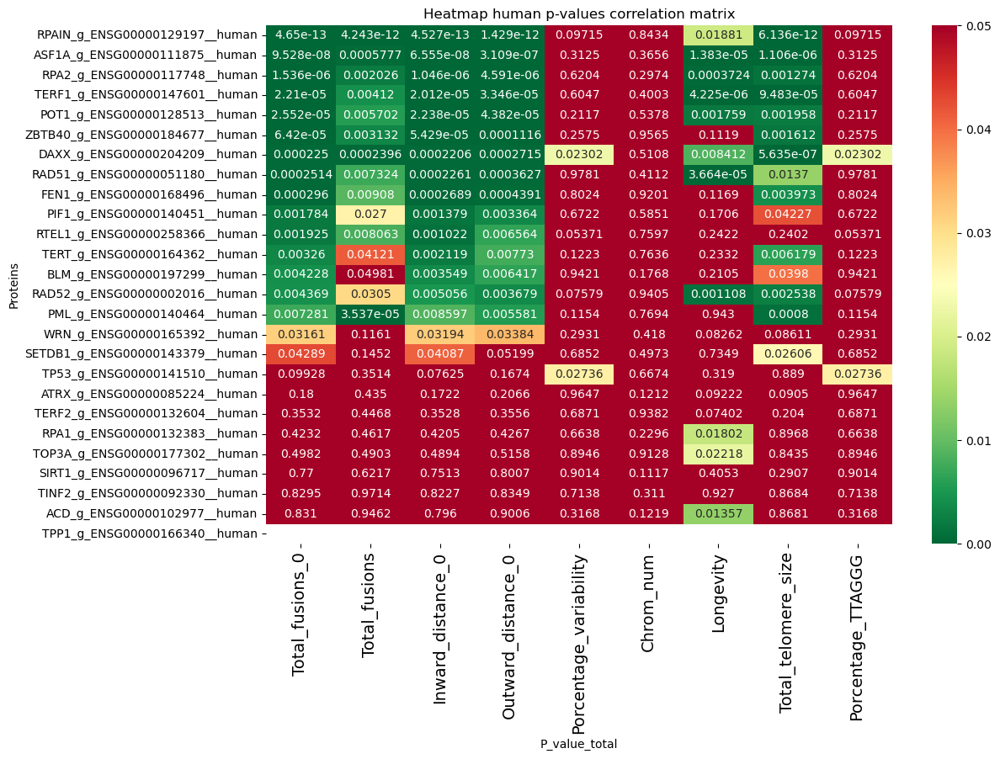

In [45]:
correlation_matrix_2_p_values = pd.read_excel('Correlation_matrix_fusions_p_value_human.xlsx', index_col='Unnamed: 0')
#correlation_matrix_2_p_values = pd.read_excel('Correlation_matrix_fusions_p_value_mouse.xlsx', index_col='Unnamed: 0')

correlation_matrix_2_p_values = correlation_matrix_2_p_values[correlation_matrix_2_p_values.index.str.contains('_g_')]
correlation_matrix_2_p_values.sort_values(by='Total_fusions_0', inplace=True)

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix_2_p_values, annot=True, cmap='RdYlGn_r', vmin=0, vmax=0.05, fmt=".4g")
plt.title('Heatmap human p-values correlation matrix')
plt.xlabel('P_value_total')
plt.ylabel('Proteins')
plt.xticks(fontsize = 14)
plt.show()

Mouse

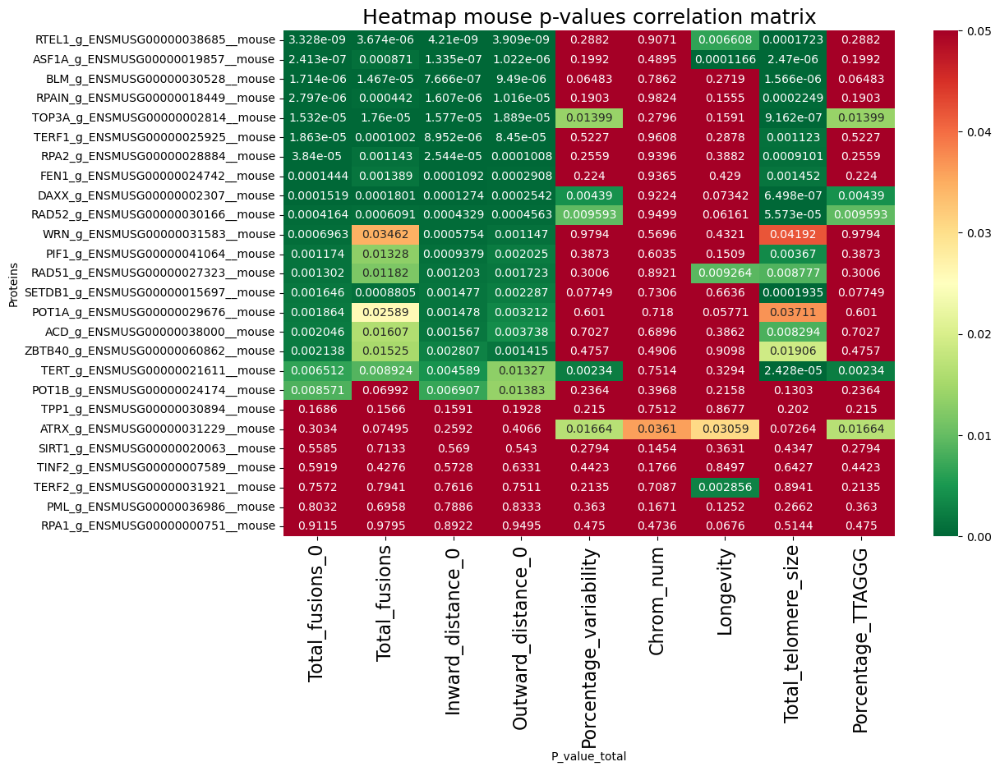

In [46]:

correlation_matrix_2_p_values = pd.read_excel('Correlation_matrix_fusions_p_value_mouse.xlsx', index_col='Unnamed: 0')

correlation_matrix_2_p_values = correlation_matrix_2_p_values[correlation_matrix_2_p_values.index.str.contains('_g_')]
correlation_matrix_2_p_values.sort_values(by='Total_fusions_0', inplace=True)

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix_2_p_values, annot=True, cmap='RdYlGn_r', vmin=0, vmax=0.05, fmt=".4g")
plt.title('Heatmap mouse p-values correlation matrix', fontsize = 18)
plt.xlabel('P_value_total')
plt.ylabel('Proteins')
plt.xticks(fontsize = 16)
plt.show()

# Detecting correaltions from different types of variables

### Analysis of 50 Species with most Total_Fusions

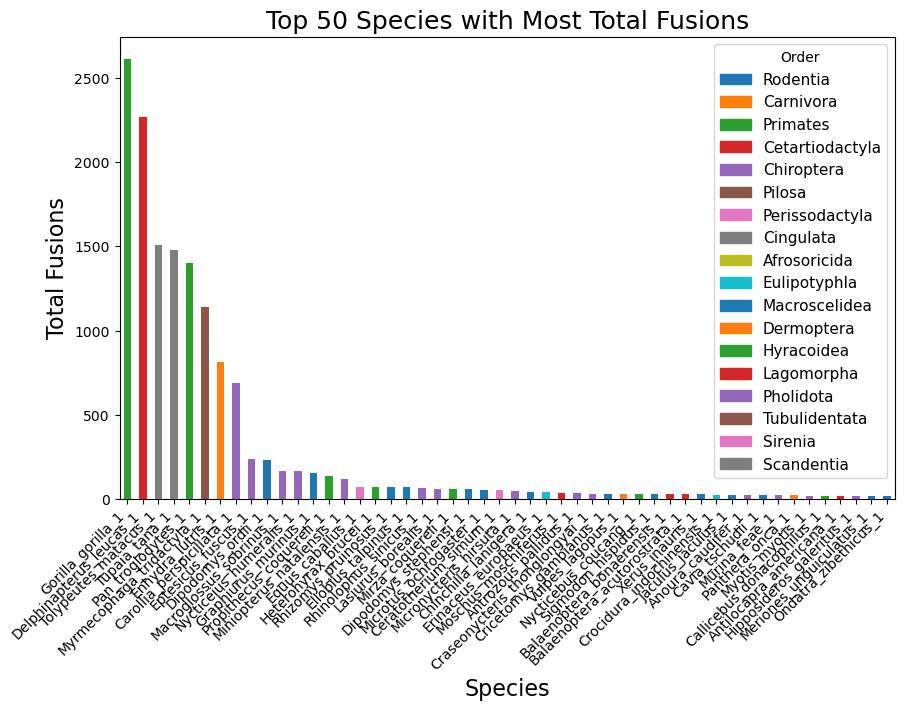

In [47]:
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df_filtered = df[df['Species_name'].str.endswith('_1')]

fusion_totals = df_filtered.groupby('Species_name')['Outward_distance_0'].sum()

top_species = fusion_totals.nlargest(50)

order_color_map = {order: color for order, color in zip(df['Order'].unique(), sns.color_palette('tab10', len(df['Order'].unique())))}

orders = df_filtered.set_index('Species_name')['Order']

colors = [order_color_map[orders[species]] for species in top_species.index]

plt.figure(figsize=(10, 6))
top_species.plot(kind='bar', color=colors)
plt.title('Top 50 Species with Most Total Fusions', fontsize = 18)
plt.xlabel('Species', fontsize = 16)
plt.ylabel('Total Fusions', fontsize = 16)
plt.xticks(rotation=45, ha='right')

# Create a legend with the order names and colors
legend_labels = {order: order_name for order, order_name in zip(df['Order'].unique(), df['Order'].unique())}
handles = [plt.Rectangle((0,0),1,1, color=order_color_map[order]) for order in df['Order'].unique()]
plt.legend(handles, legend_labels.values(), title='Order', fontsize = 11)

plt.show()

### Analysis of positive and negative correlation between fusions and other Variables

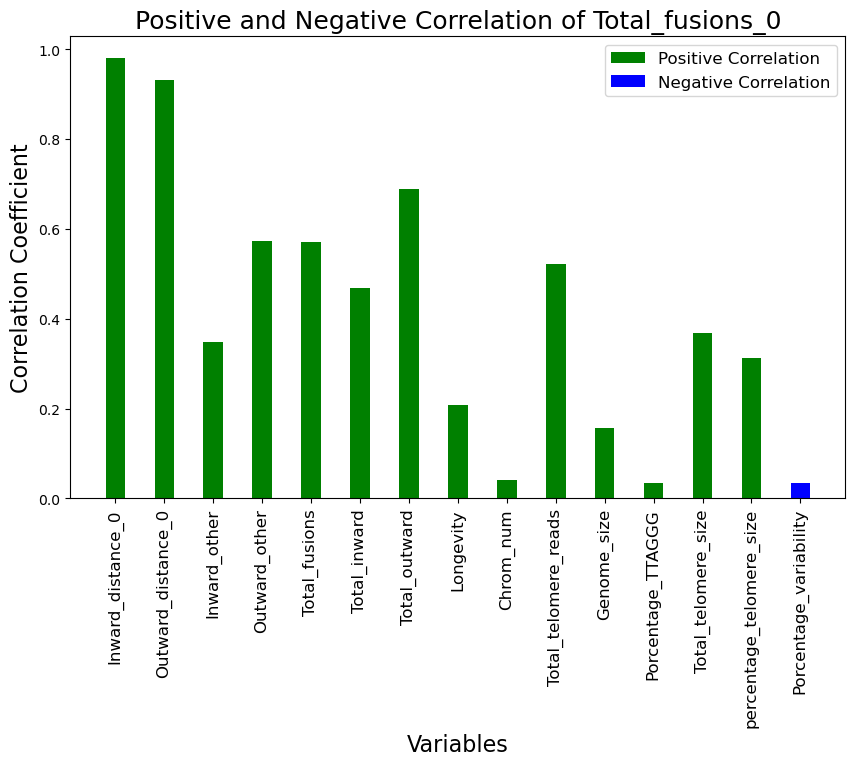

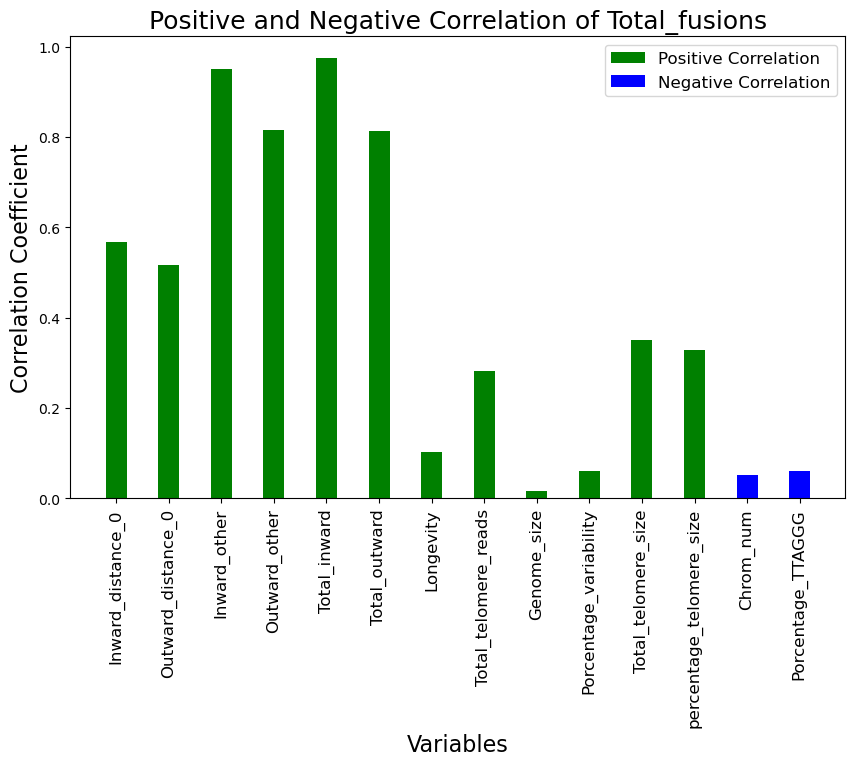

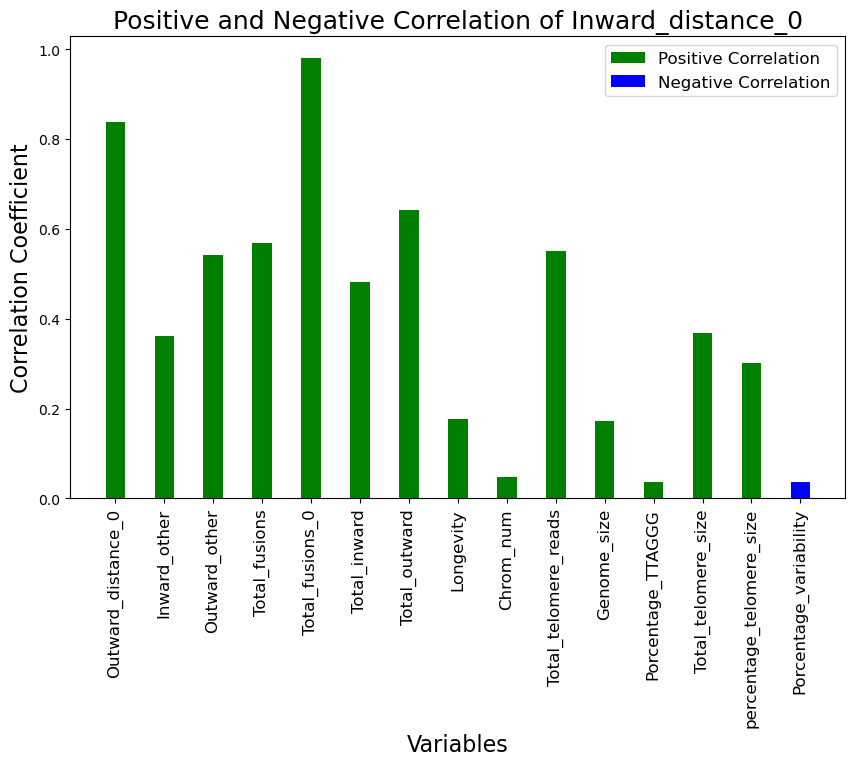

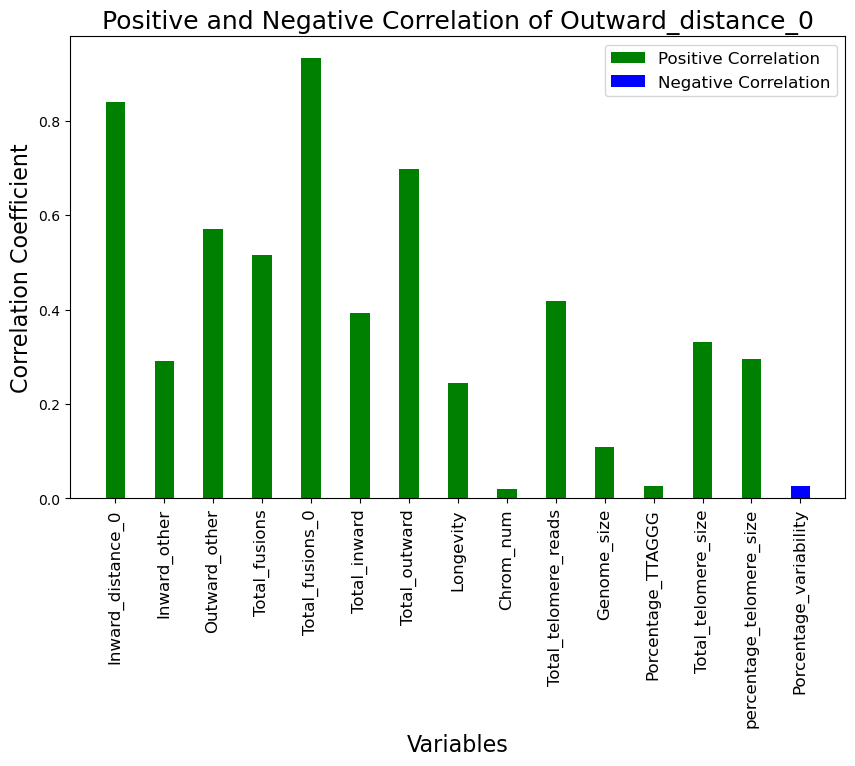

In [50]:
# Select columns of interest from the correlation matrix 
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix = pd.read_excel('Correlation_matrix_fusions_mouse.xlsx', index_col='Unnamed: 0', usecols=columns)

# Select fusion columns for analysis
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0']


for column in columns:
    # Get correlation values for the current column
    correlation = correlation_matrix[column]
    
    # Filter out proteins rows and the current column name
    correlation = correlation[~correlation.index.str.contains('_g_')]
    correlation = correlation[~correlation.index.str.contains(column)]
    
    # Separate positive and negative correlation values
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    negative_correlation_abs = np.abs(negative_correlation)
    
    # Create a bar plot showing positive and negative correlations
    plt.figure(figsize=(10, 6))
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    # Set plot title, labels, and legend
    plt.title(f'Positive and Negative Correlation of {column}', fontsize=18)
    plt.xlabel('Variables', fontsize=16)
    plt.ylabel('Correlation Coefficient', fontsize=16)
    plt.xticks(rotation=90, fontsize=12)
    plt.legend(fontsize=12)
    
    plt.show()

### Analysis of positive and negative correlation between telomere variability and size and other Variables

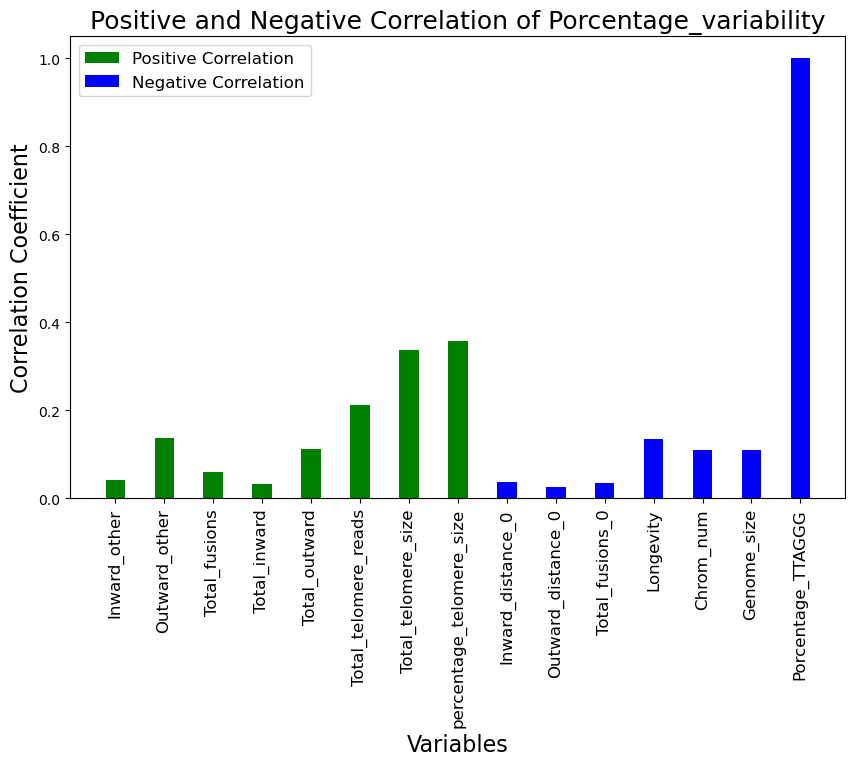

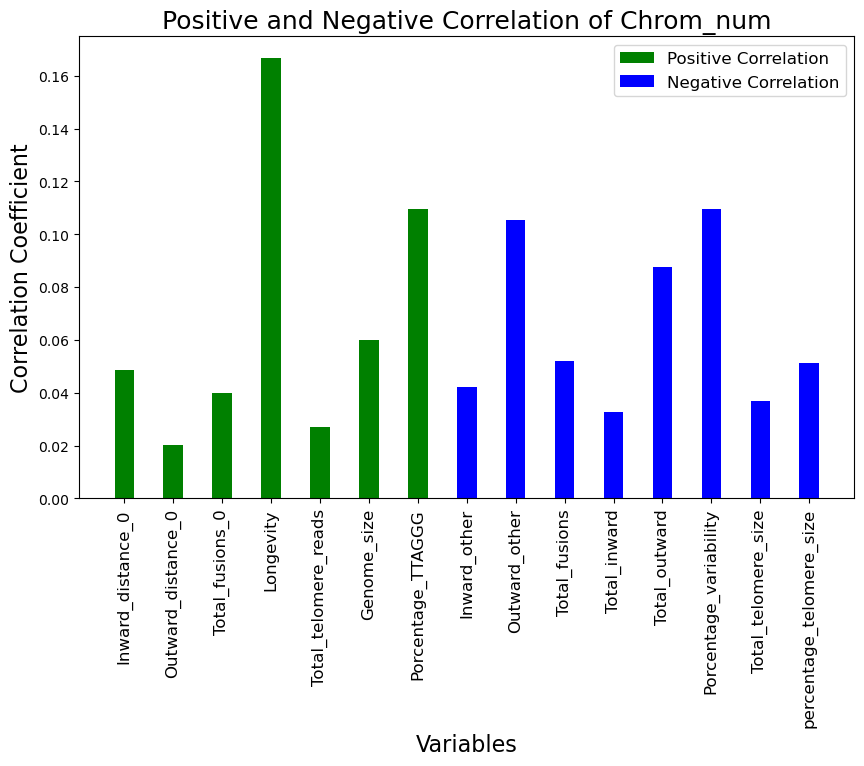

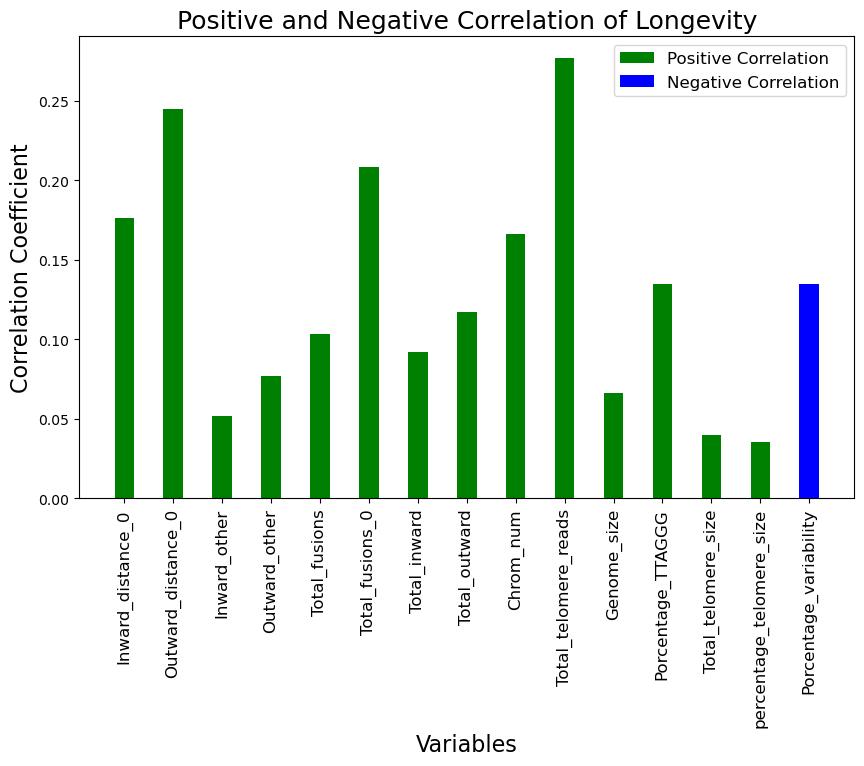

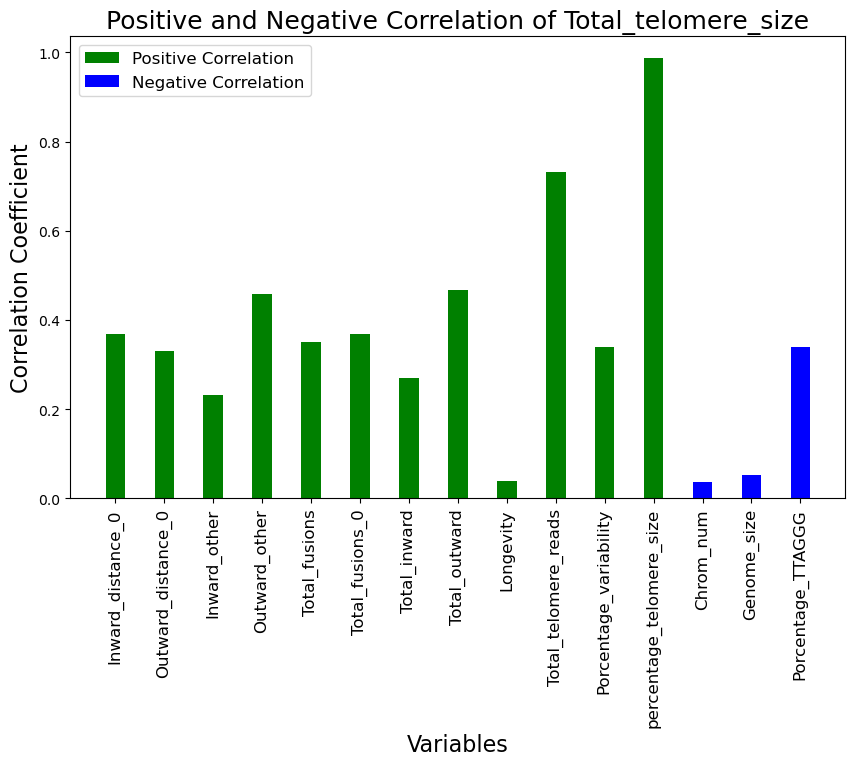

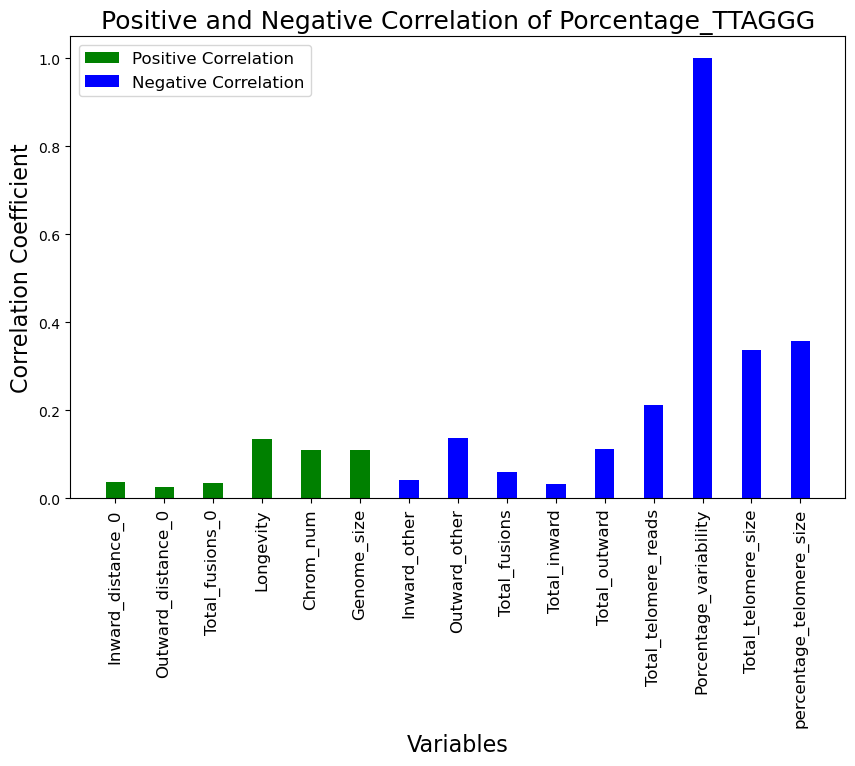

In [52]:
columns = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:
    # Filter out proteins rows and the current column name
    correlation = correlation_matrix[column]
    correlation = correlation[~correlation.index.str.contains('_g_')]
    correlation = correlation[~correlation.index.str.contains(column)]
    # Separate positive and negative correlation values
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    # Create a bar plot showing positive and negative correlations
    plt.title(f'Positive and Negative Correlation of {column}', fontsize = 18)
    plt.xlabel('Variables', fontsize = 16)
    plt.ylabel('Correlation Coefficient', fontsize = 16)
    plt.xticks(rotation=90, fontsize = 12)
    plt.legend(fontsize = 12)
    
    plt.show()

### Analysis of positive and negative correlation between fusions and proteins

MOUSE

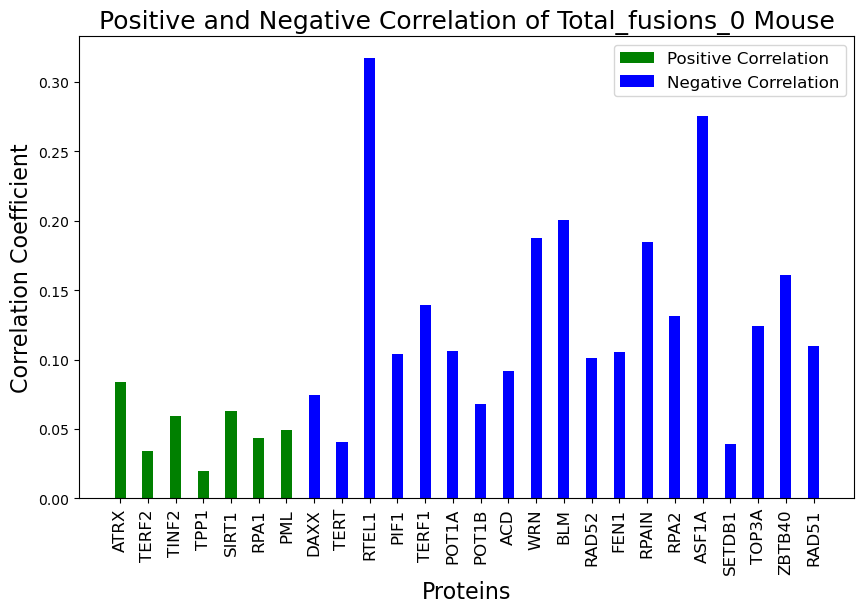

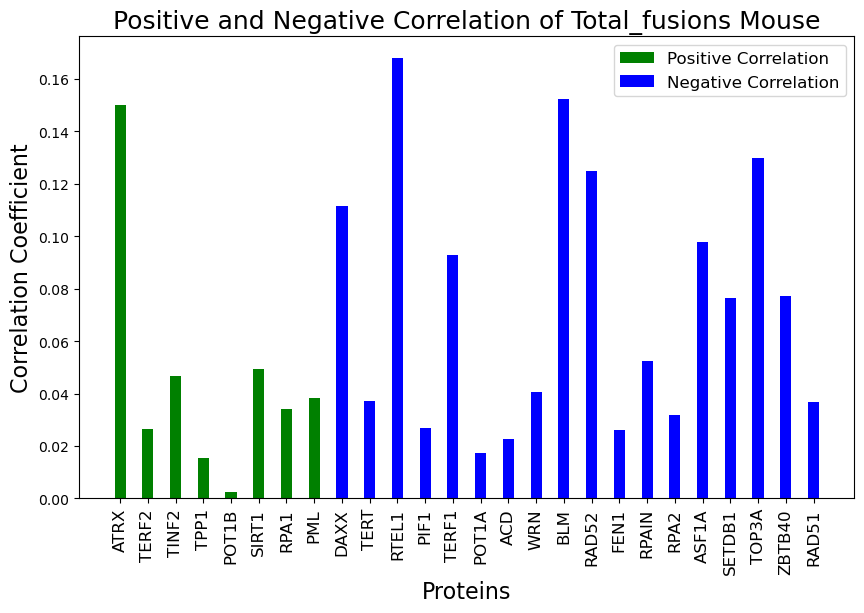

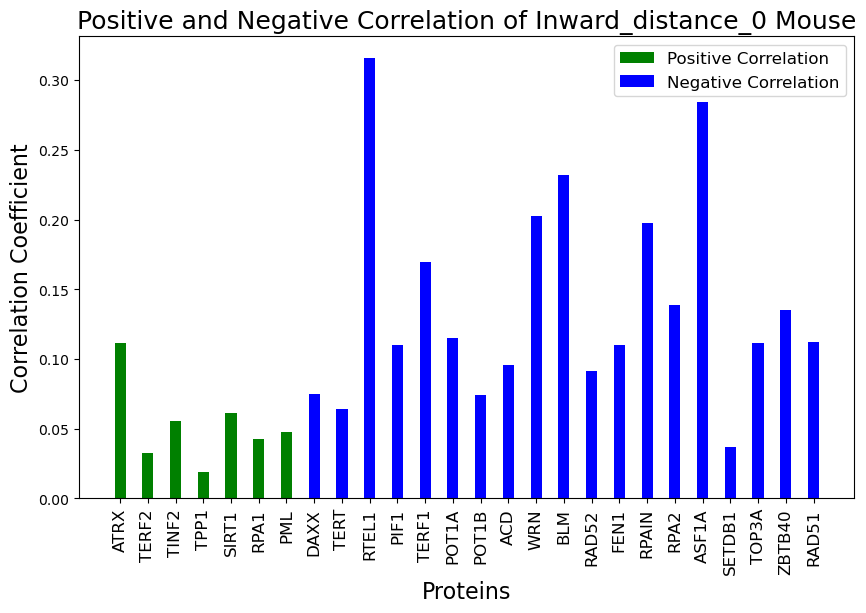

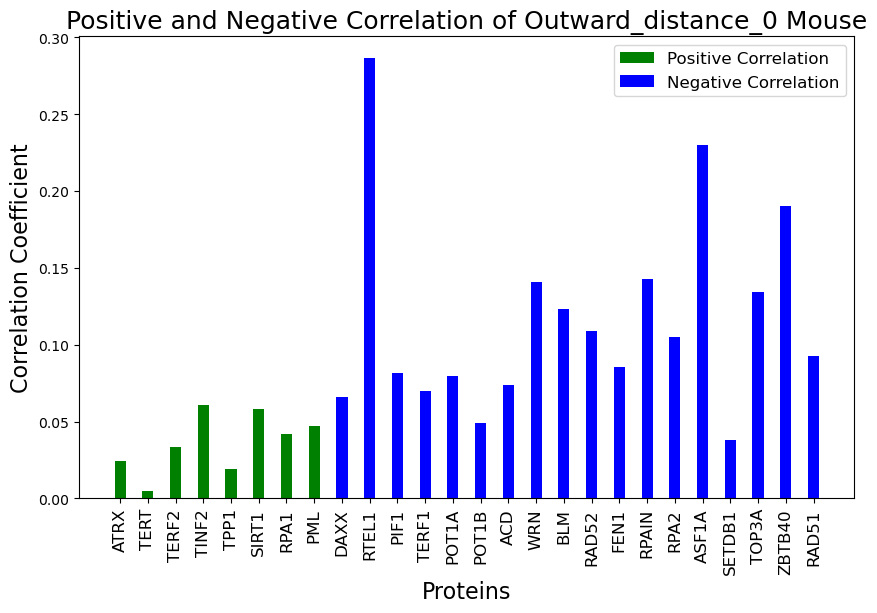

In [54]:
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix = pd.read_excel('Correlation_matrix_fusions_mouse.xlsx', index_col='Unnamed: 0', usecols=columns)

# Create a function to get the protein name
def process_protein_name(name):
    return name.split('_')[0]
# Columns to analyse
columns = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']

for column in columns:
    correlation = correlation_matrix[column]
    # Geting only the proteins
    correlation = correlation[correlation.index.str.contains('_g_')]
    # Separate positive and negative correlation values
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
    negative_correlation_abs = np.abs(negative_correlation)
    
    # Creating a bar plot for each column showing the correlation
    plt.figure(figsize=(10, 6))
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} Mouse', fontsize = 18)
    plt.xlabel('Proteins', fontsize = 16)
    plt.ylabel('Correlation Coefficient', fontsize = 16)
    plt.xticks(rotation=90, fontsize = 12)
    plt.legend(fontsize = 12)
    
    plt.show()

### Analysis of positive and negative correlation between telomere variability and proteins

Mouse

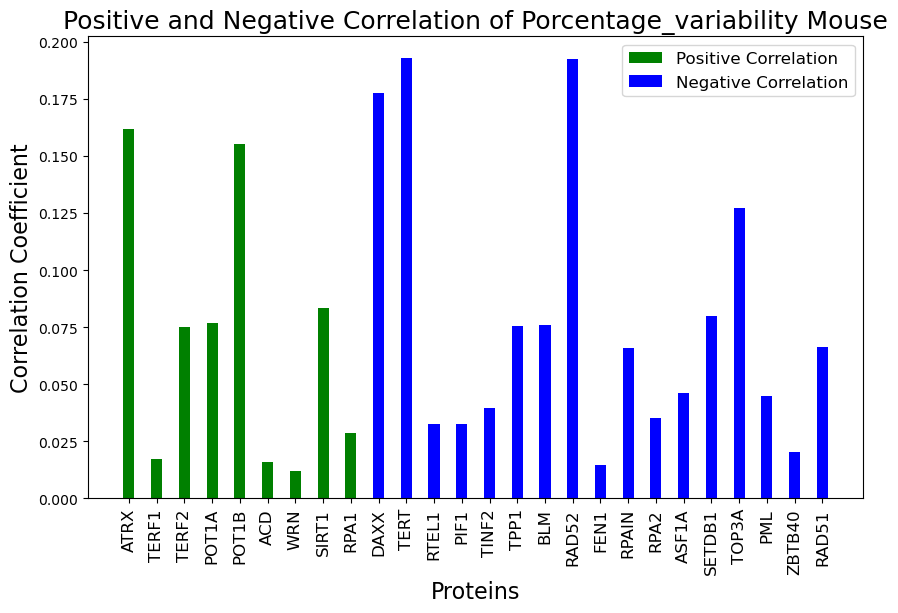

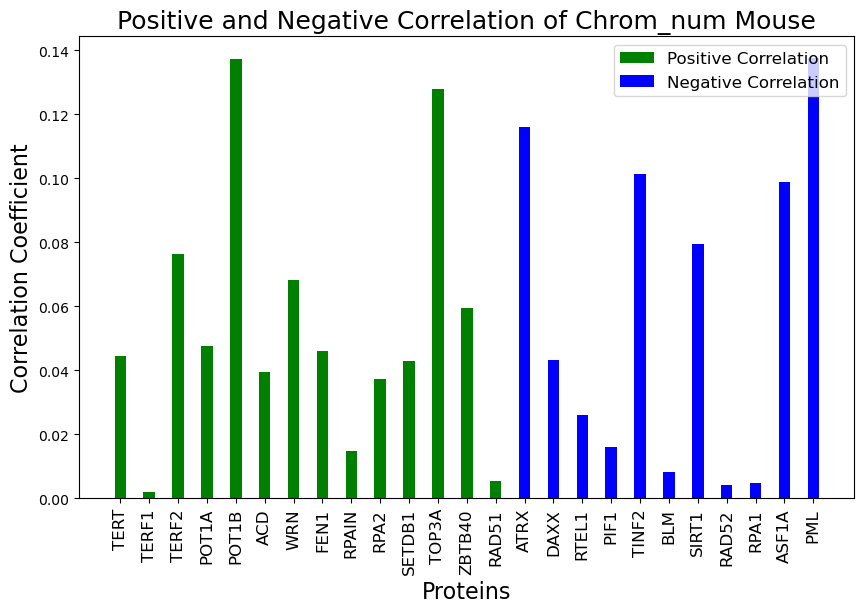

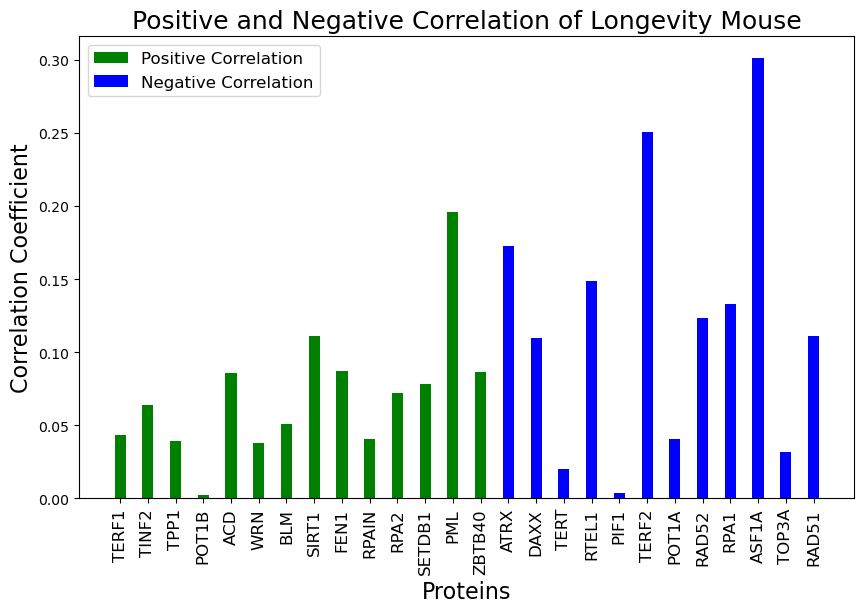

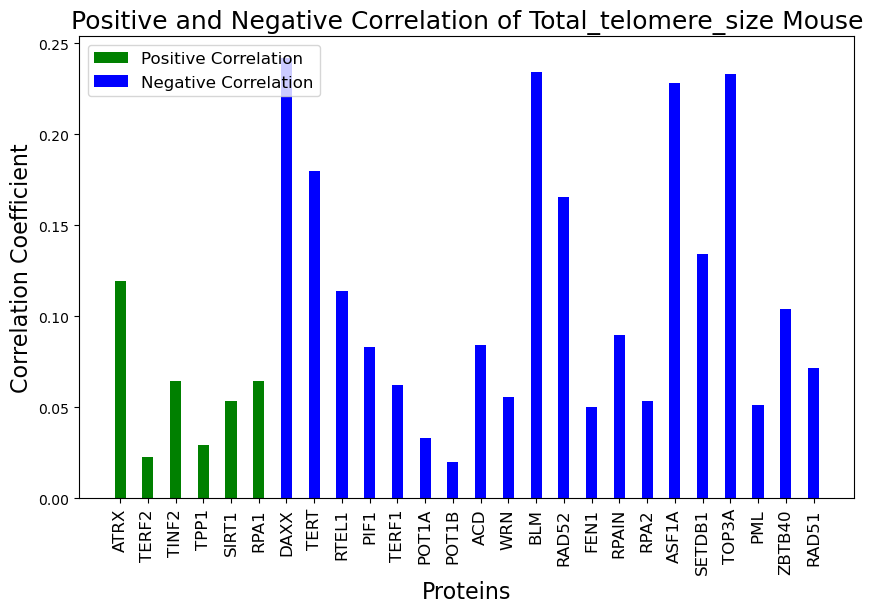

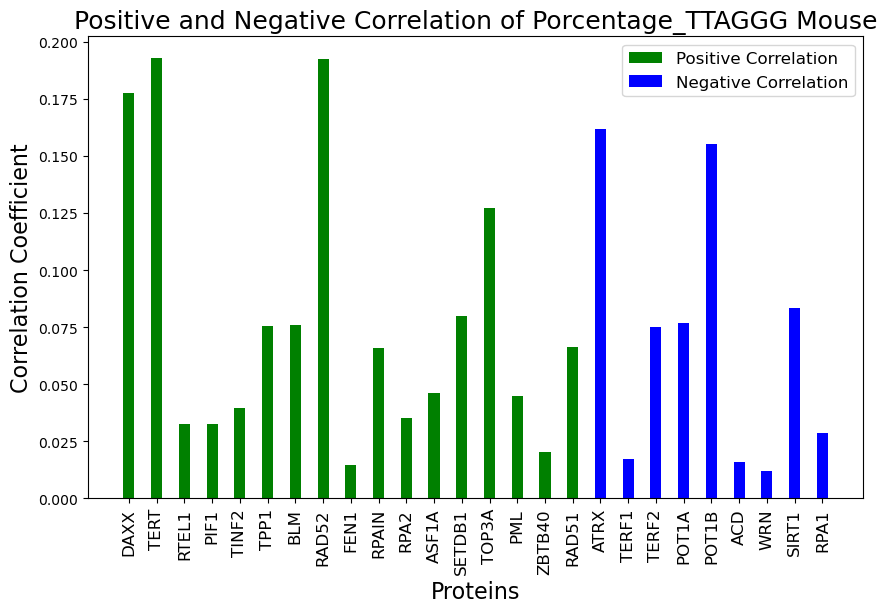

In [55]:

# Columns to analyse
columns = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']


for column in columns:
    correlation = correlation_matrix[column]
    # Geting only the proteins
    correlation = correlation[correlation.index.str.contains('_g_')]
    # Separate positive and negative correlation values
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
    negative_correlation_abs = np.abs(negative_correlation)
    
    # Creating a bar plot for each column showing the correlation
    plt.figure(figsize=(10, 6))
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} Mouse', fontsize = 18)
    plt.xlabel('Proteins', fontsize = 16)
    plt.ylabel('Correlation Coefficient', fontsize = 16)
    plt.xticks(rotation=90, fontsize = 12)
    plt.legend(fontsize = 12)
    
    plt.show()

### Analysis of positive and negative correlation between Fusions and proteins

HUMAN

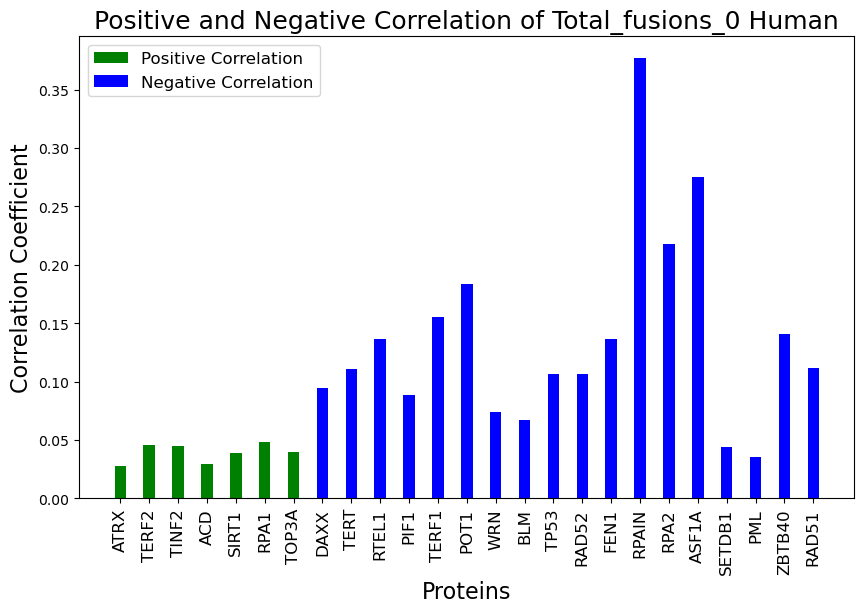

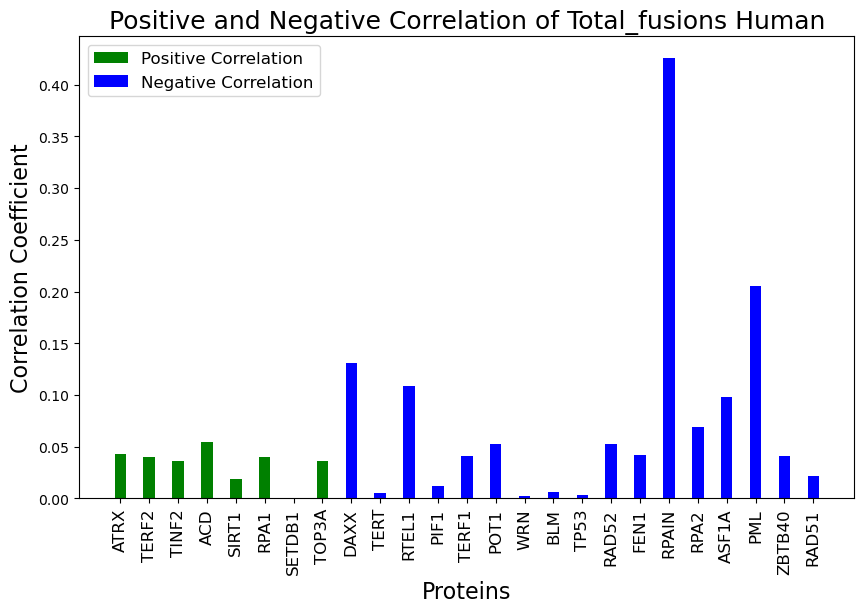

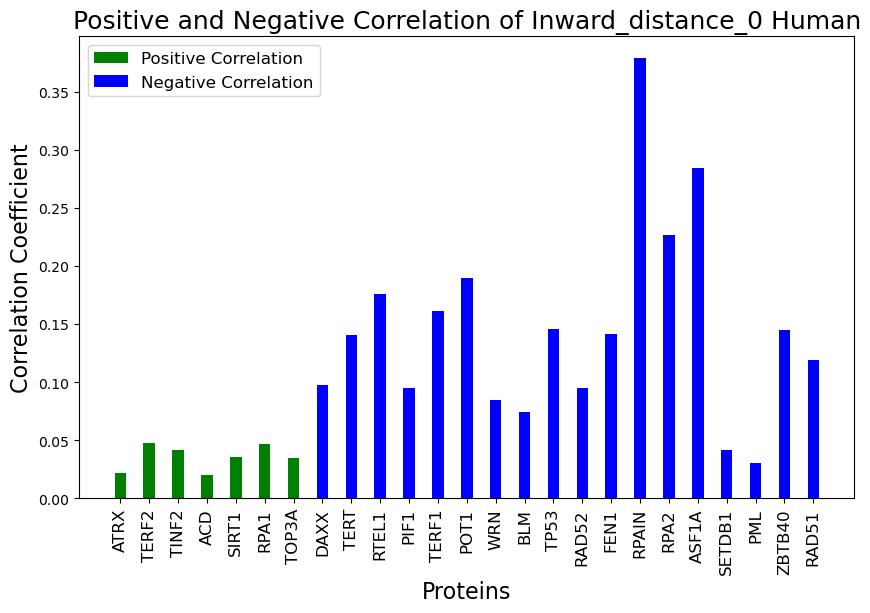

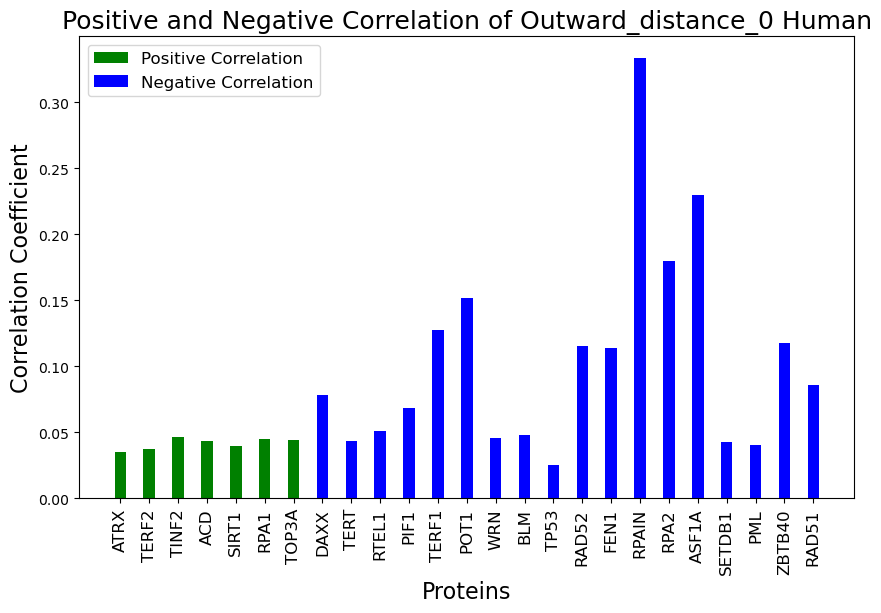

In [58]:
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix = pd.read_excel('Correlation_matrix_fusions_human.xlsx', index_col='Unnamed: 0', usecols=columns)


def process_protein_name(name):
    return name.split('_')[0]

columns = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']

for column in columns:
    correlation = correlation_matrix[column]
    
    correlation = correlation[correlation.index.str.contains('_g_')]
    
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
        
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} Human', fontsize = 18)
    plt.xlabel('Proteins', fontsize = 16)
    plt.ylabel('Correlation Coefficient', fontsize = 16)
    plt.xticks(rotation=90, fontsize = 12)
    plt.legend(fontsize = 12)
    
    plt.show()

### Analysis of positive and negative correlation between telomere variability and proteins

Human

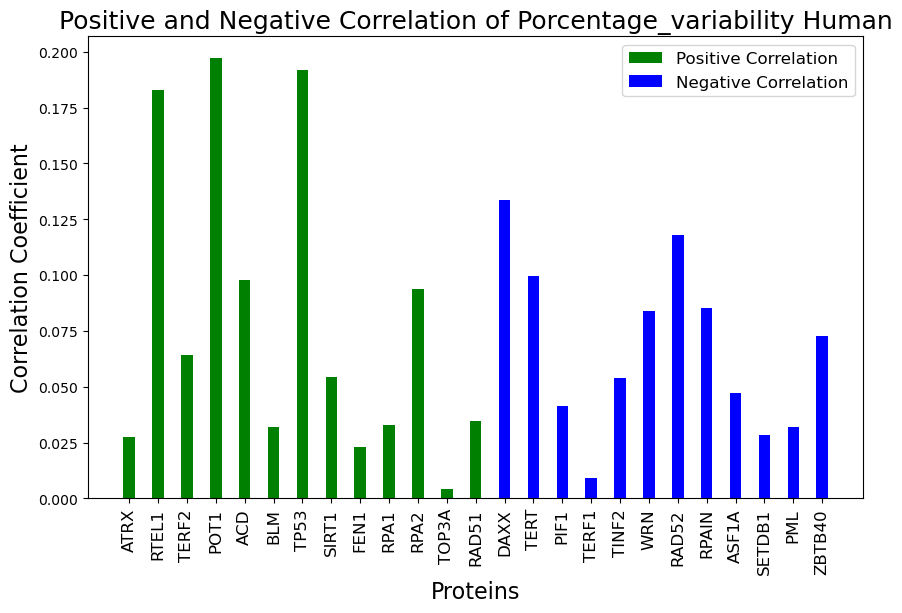

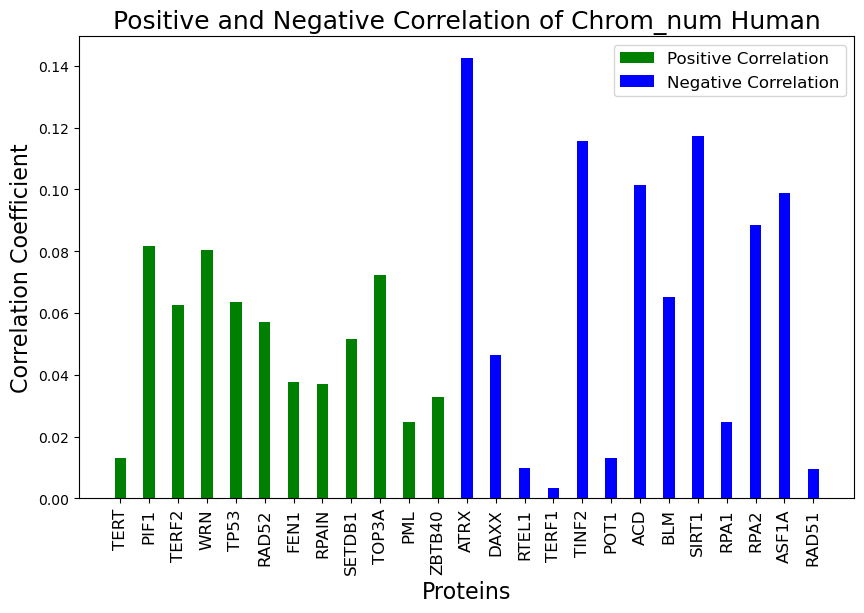

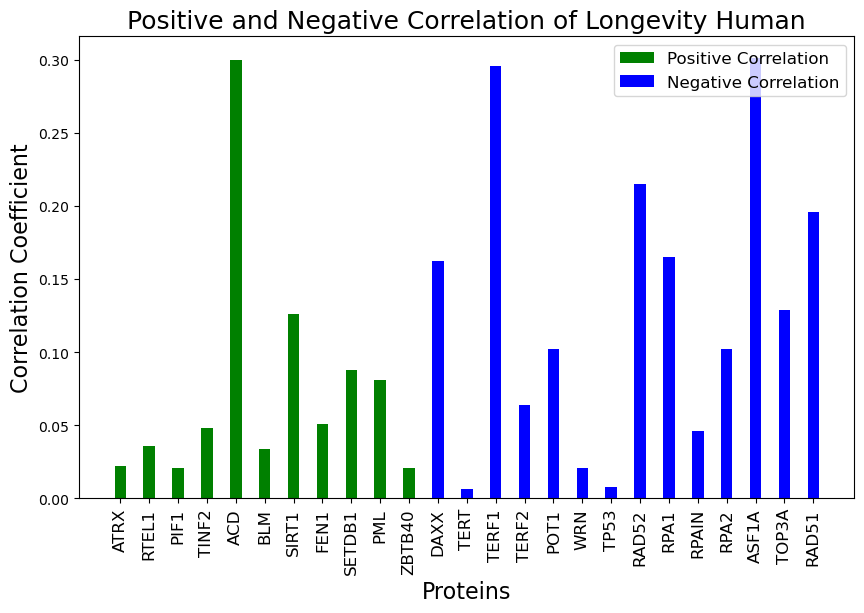

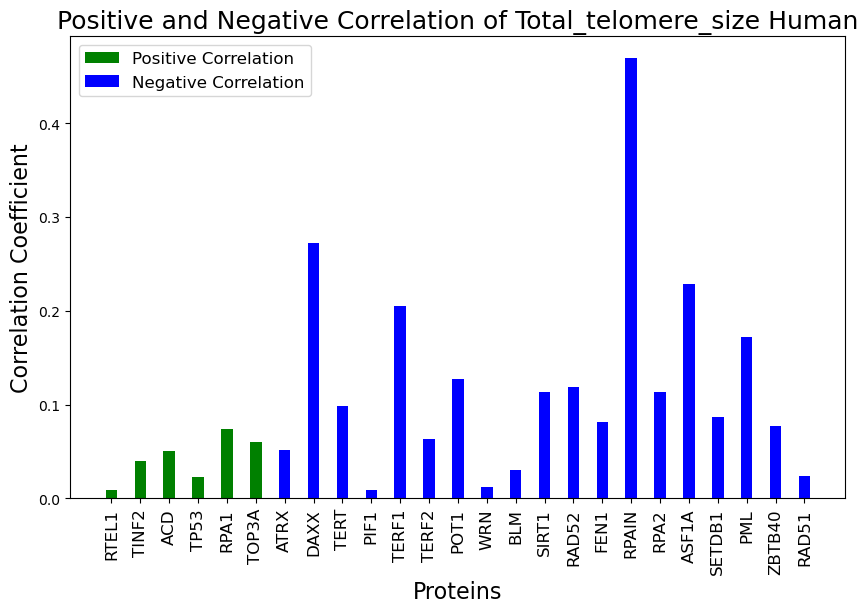

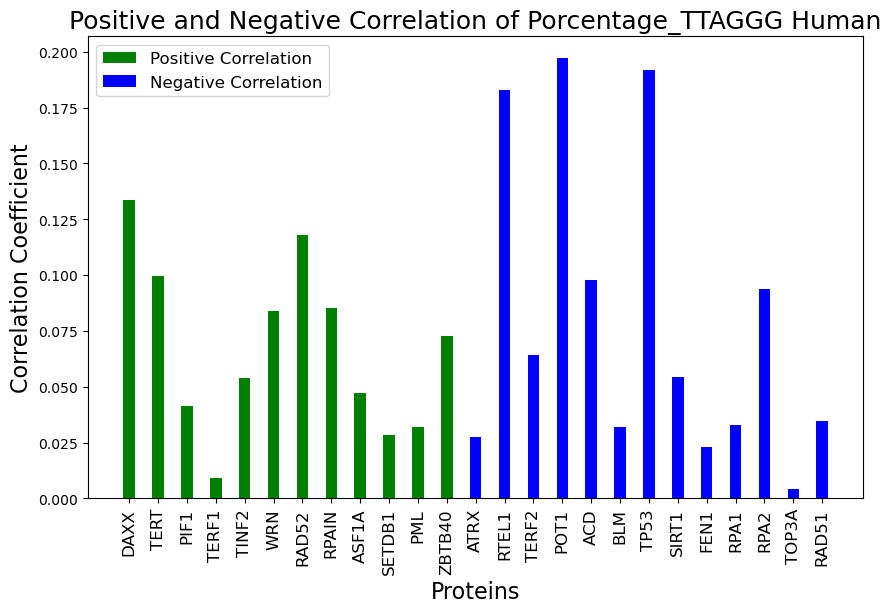

In [59]:
columns = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:

    correlation = correlation_matrix[column]
    correlation = correlation[correlation.index.str.contains('_g_')]
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} Human', fontsize = 18)
    plt.xlabel('Proteins', fontsize = 16)
    plt.ylabel('Correlation Coefficient', fontsize = 16)
    plt.xticks(rotation=90, fontsize = 12)
    plt.legend(fontsize = 12)
    
    plt.show()

### Comparing Fusions vs other variables by order with a minimum of 10 samples

I compared fusions with the other variables excluding proteins, then I added the regresion line which gives us an idea if there is any difference beteewn orders

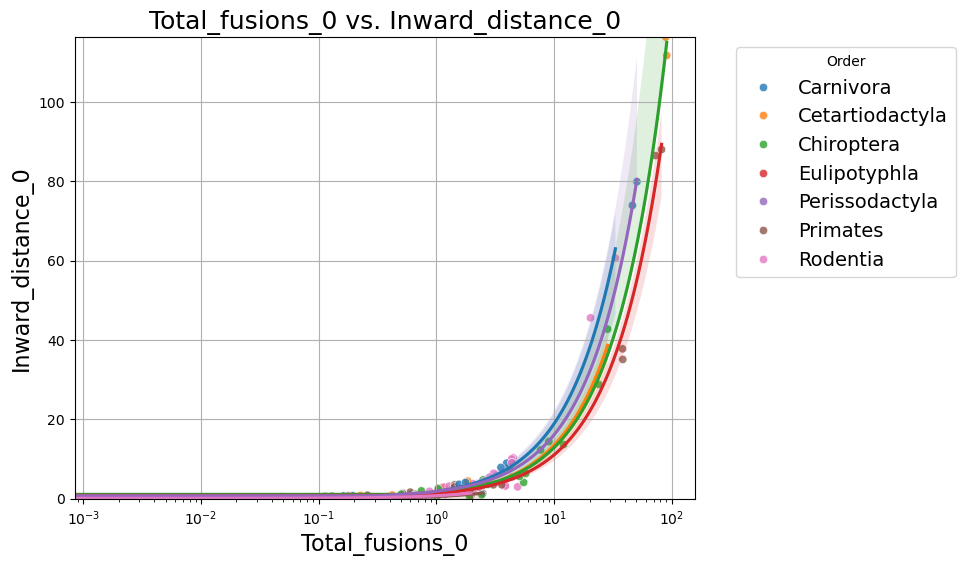

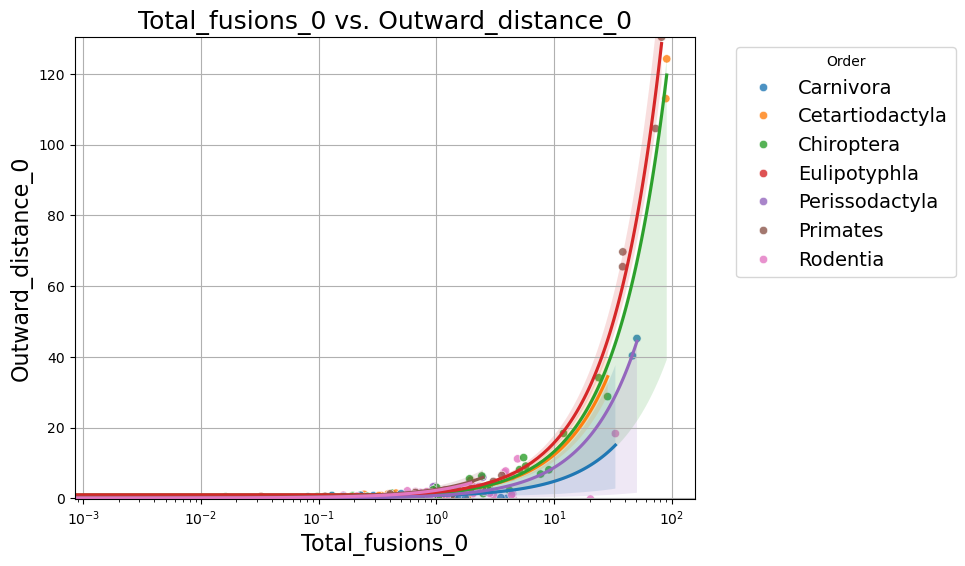

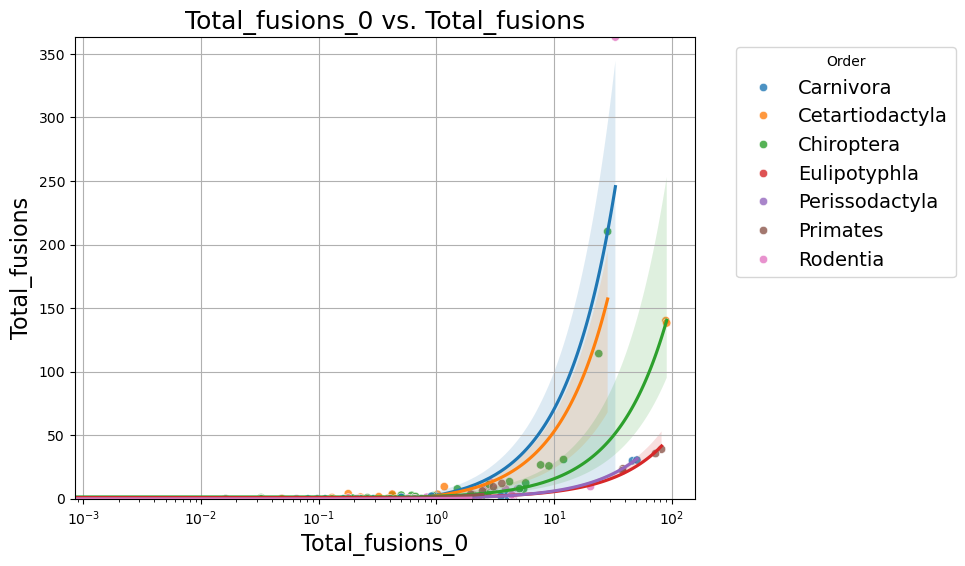

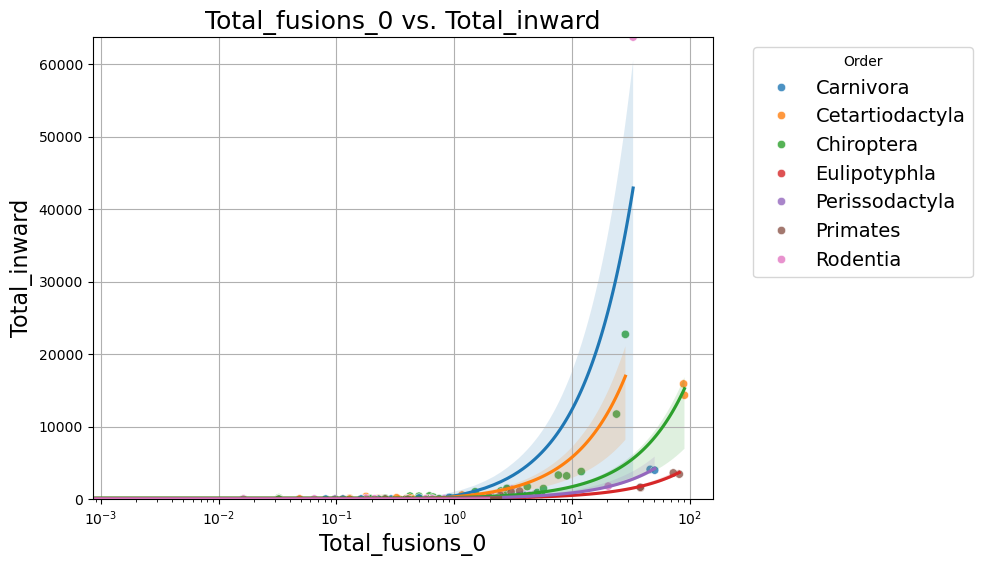

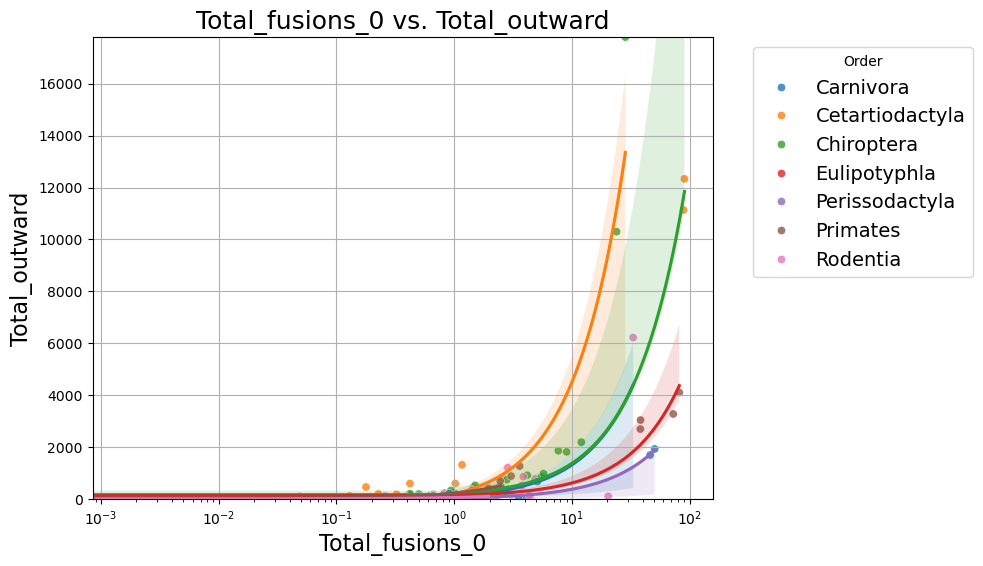

...

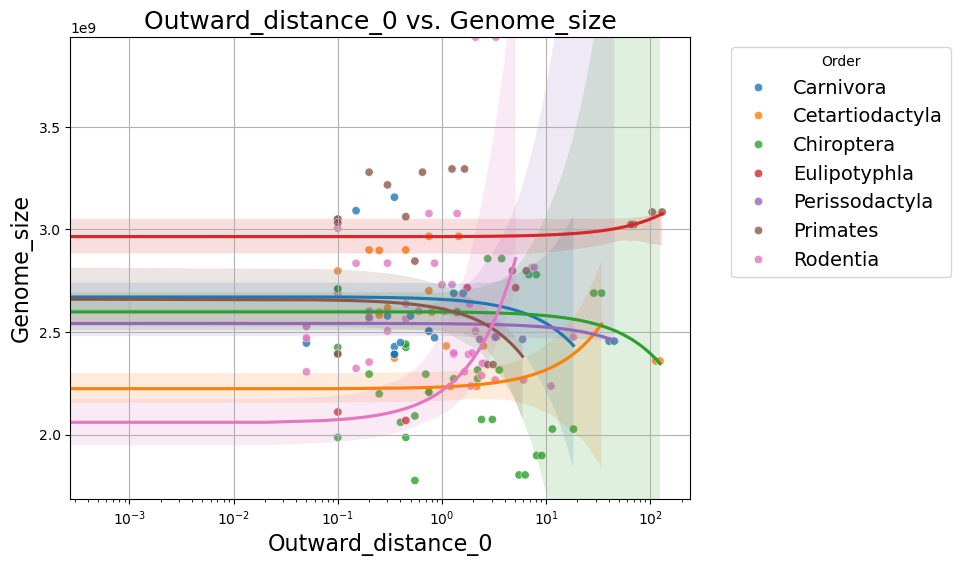

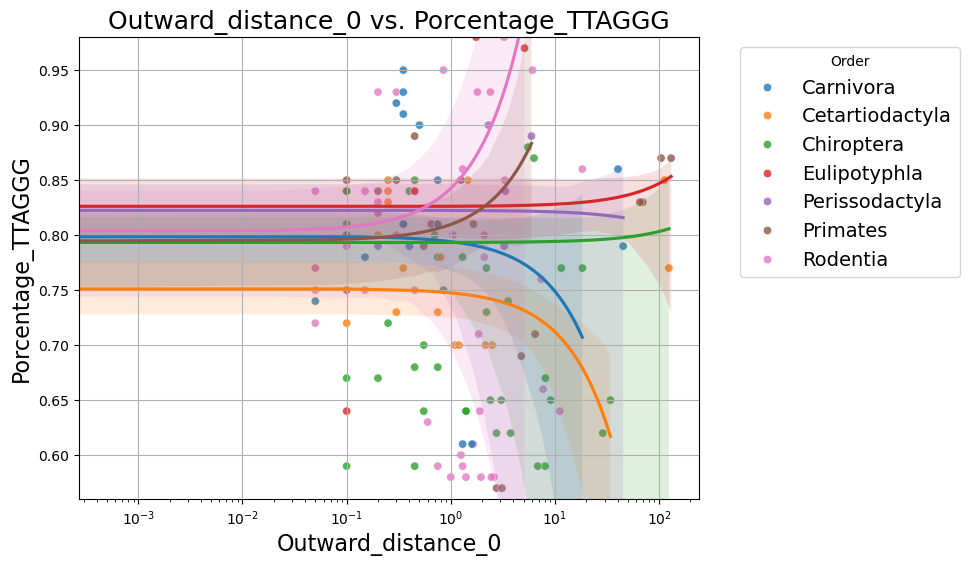

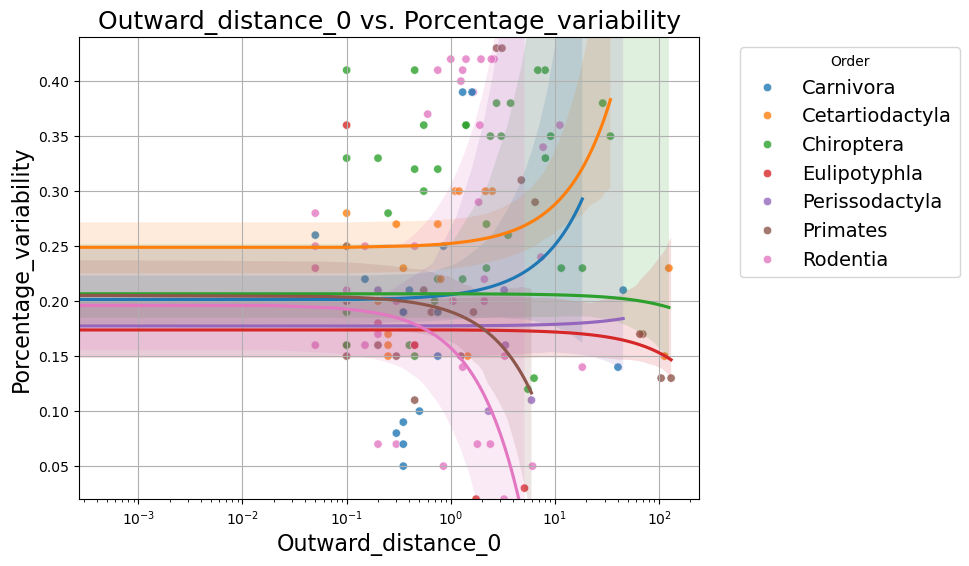

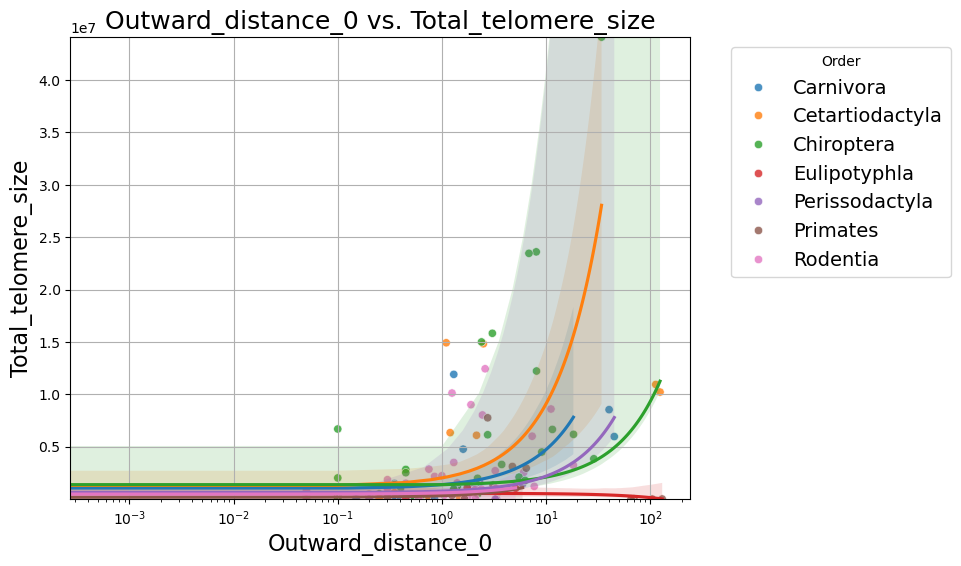

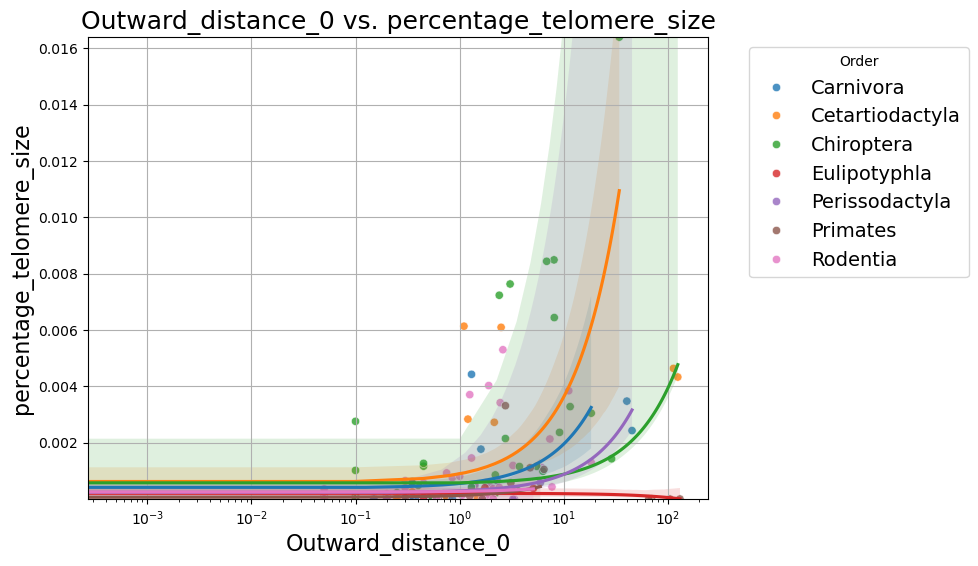

In [83]:

# Read the dataset and drop unnecessary columns and rows with many missing values
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df.drop(['Species_name', 'Species', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
df = df.dropna(thresh=df.shape[1] - 4)

# Filter to include only 'Order' groups with at least 10 samples
order_counts = df['Order'].value_counts()
valid_orders = order_counts[order_counts >= 10].index.tolist()
df = df[df['Order'].isin(valid_orders)]
df['Order'] = df['Order'].astype('category')

# Define palette for plotting
palette = sns.color_palette("tab10", len(valid_orders))

# Define columns of interest and columns to be transformed logarithmically
rows_of_study = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']


# Apply RobustScaler to logarithmic columns to normalize the data
scaler = RobustScaler()
df[rows_of_study] = scaler.fit_transform(df[rows_of_study])

for row_of_study in rows_of_study:
    for column in df.columns:
        if column not in [row_of_study, 'Order']:
            # Create scatter plot
            plt.figure(figsize=(8, 6))
            sns.scatterplot(x=row_of_study, y=column, hue='Order', data=df, alpha=0.8 , palette=palette)
            
            # Add regression line for each 'Order'
            for i, order in enumerate(valid_orders):
                df_order = df[df['Order'] == order]
                correlation = df_order[[row_of_study, column]].corr().iloc[0, 1]
                sns.regplot(x=row_of_study, y=column, data=df_order, scatter=False, color=palette[i], line_kws={'label': f'Order {order} (Correlation: {correlation:.2f})'})
            
            # Set plot
            plt.xlabel(row_of_study, fontsize=16)
            plt.ylabel(column, fontsize=16)
            plt.title(f'{row_of_study} vs. {column}', fontsize=18)
            plt.grid(True)
            plt.xscale('log')
            plt.ylim(df[column].min(), df[column].max())
            
            plt.legend(title='Order', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=14)
            plt.show()

### Comparing Telomere variability, telomere size, longevity and number of chromosomes vs other variables by order with a minimum of 10 samples

In [ ]:
# Read the dataset and drop unnecessary columns and rows with many missing values
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df.drop(['Species_name', 'Species', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
df = df.dropna(thresh=df.shape[1] - 4)

# Filter to include only 'Order' groups with at least 10 samples
order_counts = df['Order'].value_counts()
valid_orders = order_counts[order_counts >= 10].index.tolist()
df2 = df[df['Order'].isin(valid_orders)]
df2['Order'] = df2['Order'].astype('category')

palette = sns.color_palette("tab10", len(valid_orders))

# Define columns of interest and columns to be transformed logarithmically
rows_of_study = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size']
log_columns = ['Total_fusions', 'Total_fusions_0', 'Inward_distance_0', 'Outward_distance_0', 'Total_inward', 'Total_outward']

# Apply RobustScaler to logarithmic columns to normalize the data
scaler = RobustScaler()
df2[log_columns] = scaler.fit_transform(df2[log_columns])

for row_of_study in rows_of_study:
    for column in df2.columns:
        if column not in [row_of_study, 'Order']:
            # Create scatter plot
            plt.figure(figsize=(8, 6))
            sns.scatterplot(x=row_of_study, y=column, hue='Order', data=df2, alpha=0.8, palette=palette)
            
            # Add regression line for each 'Order'
            for i, order in enumerate(valid_orders):
                df_order = df2[df2['Order'] == order]
                correlation = df_order[[row_of_study, column]].corr().iloc[0, 1]
                sns.regplot(x=row_of_study, y=column, data=df_order, scatter=False, color=palette[i], line_kws={'label': f'Order {order} (Correlation: {correlation:.2f})'})

            # Set plot
            plt.xlabel(row_of_study, fontsize=16)
            plt.ylabel(column, fontsize=16)
            plt.title(f'{row_of_study} vs. {column}', fontsize=18)
            plt.grid(True)
            plt.ylim(df2[column].min(), df2[column].max())
            
            plt.legend(title='Order', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=14)
            plt.show()

# Calculation of P-value of the correlation using Kluskal Wallis

I calculated the p-value of 6 variables, total_fusions_0, total_fusions, Inward_distance_0, Outward_distance_0, Porcentage_variability and Total_telomere_size

Mouse

In [62]:

df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')

df = df.dropna(thresh=df.shape[1] - 4)
#df = df[df['Instrument_model'] != 'NextSeq 500']
#df = df[~df['Species_name'].str.endswith('_2')]

# Select relevant columns
protein_columns = df.filter(like='_g_').columns
total_fusions_0 = df['Total_fusions_0']
total_fusions = df['Total_fusions']
Inward_0 = df['Inward_distance_0']
Outward_0 = df['Outward_distance_0']
variability = df['Porcentage_variability']
telomere_size = df['Total_telomere_size']

# Initialize dictionaries to store p-values for each protein
p_values_k_I = {}
p_values_k_F = {}
p_values_k_O = {}
p_values_k_T = {}
p_values_k_V = {}
p_values_k_S = {}

# Compute Kruskal-Wallis test for each protein
for protein in protein_columns:
    group_T = [total_fusions_0[df[protein] == category] for category in [True, False]]
    group_F = [total_fusions[df[protein] == category] for category in [True, False]]
    group_I = [Inward_0[df[protein] == category] for category in [True, False]]
    group_O = [Outward_0[df[protein] == category] for category in [True, False]]
    group_V = [variability[df[protein] == category] for category in [True, False]]
    group_S = [telomere_size[df[protein] == category] for category in [True, False]]
    
    stat, p_value_t = kruskal(*group_T)
    stat, p_value_f = kruskal(*group_F)
    stat, p_value_i = kruskal(*group_I)
    stat, p_value_o = kruskal(*group_O)
    stat, p_value_v = kruskal(*group_V)
    stat, p_value_s = kruskal(*group_S)

    # Store p-values in dictionaries
    p_values_k_T[protein] = p_value_t
    p_values_k_F[protein] = p_value_f
    p_values_k_I[protein] = p_value_o
    p_values_k_O[protein] = p_value_i
    p_values_k_V[protein] = p_value_v
    p_values_k_S[protein] = p_value_s

# Convert dictionaries to pandas Series
p_values_T_series = pd.Series(p_values_k_T, name='Total_fusions_0')
p_values_F_series = pd.Series(p_values_k_F, name='Total_fusions')
p_values_I_series = pd.Series(p_values_k_I, name='Inward_distance_0')
p_values_O_series = pd.Series(p_values_k_O, name='Outward_distance_0')
p_values_V_series = pd.Series(p_values_k_V, name='Porcentage_variability')
p_values_S_series = pd.Series(p_values_k_S, name='Total_telomere_size')

# Concatenate all Series into a single DataFrame and save to Excel
result_df = pd.concat([p_values_T_series, p_values_F_series, p_values_I_series, p_values_O_series, p_values_V_series, p_values_S_series], axis=1)
result_df.to_excel('kruskal_mouse_p_values.xlsx', index=True)

Human

In [63]:
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')

df = df.dropna(thresh=df.shape[1] - 4)
#df = df[df['Instrument_model'] != 'NextSeq 500']
#df = df[~df['Species_name'].str.endswith('_2')]

# Select relevant columns
protein_columns = df.filter(like='_g_').columns
total_fusions_0 = df['Total_fusions_0']
total_fusions = df['Total_fusions']
Inward_0 = df['Inward_distance_0']
Outward_0 = df['Outward_distance_0']
variability = df['Porcentage_variability']
telomere_size = df['Total_telomere_size']

# Initialize dictionaries to store p-values for each protein
p_values_k_I = {}
p_values_k_F = {}
p_values_k_O = {}
p_values_k_T = {}
p_values_k_V = {}
p_values_k_S = {}

# Compute Kruskal-Wallis test for each protein
for protein in protein_columns:
    group_T = [total_fusions_0[df[protein] == category] for category in [True, False]]
    group_F = [total_fusions[df[protein] == category] for category in [True, False]]
    group_I = [Inward_0[df[protein] == category] for category in [True, False]]
    group_O = [Outward_0[df[protein] == category] for category in [True, False]]
    group_V = [variability[df[protein] == category] for category in [True, False]]
    group_S = [telomere_size[df[protein] == category] for category in [True, False]]
    
    stat, p_value_t = kruskal(*group_T)
    stat, p_value_f = kruskal(*group_F)
    stat, p_value_i = kruskal(*group_I)
    stat, p_value_o = kruskal(*group_O)
    stat, p_value_v = kruskal(*group_V)
    stat, p_value_s = kruskal(*group_S)

    # Store p-values in dictionaries
    p_values_k_T[protein] = p_value_t
    p_values_k_F[protein] = p_value_f
    p_values_k_I[protein] = p_value_o
    p_values_k_O[protein] = p_value_i
    p_values_k_V[protein] = p_value_v
    p_values_k_S[protein] = p_value_s

# Convert dictionaries to pandas Series
p_values_T_series = pd.Series(p_values_k_T, name='Total_fusions_0')
p_values_F_series = pd.Series(p_values_k_F, name='Total_fusions')
p_values_I_series = pd.Series(p_values_k_I, name='Inward_distance_0')
p_values_O_series = pd.Series(p_values_k_O, name='Outward_distance_0')
p_values_V_series = pd.Series(p_values_k_V, name='Porcentage_variability')
p_values_S_series = pd.Series(p_values_k_S, name='Total_telomere_size')

# Concatenate all Series into a single DataFrame and save it to Excel
result_df = pd.concat([p_values_T_series, p_values_F_series, p_values_I_series, p_values_O_series, p_values_V_series, p_values_S_series], axis=1)
result_df.to_excel('kruskal_mouse_p_values.xlsx', index=True)

### Comparing Fusions vs proteins adding the correlation coeficient and the p-value of Kluskal Wallis

Mouse

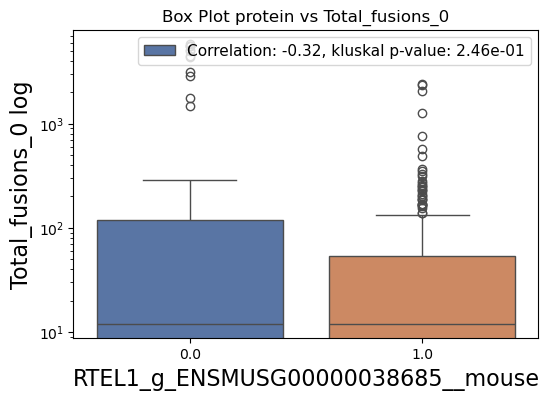

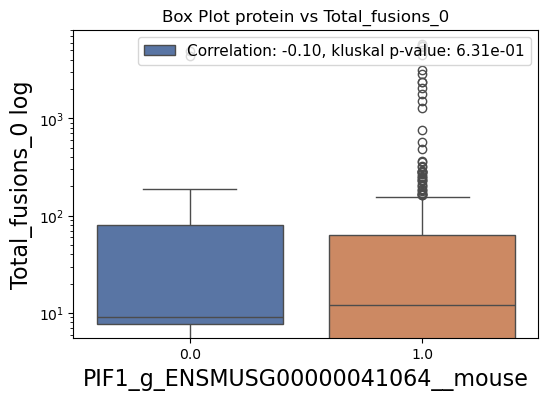

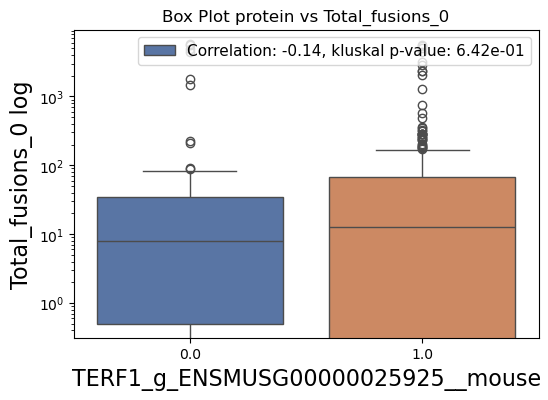

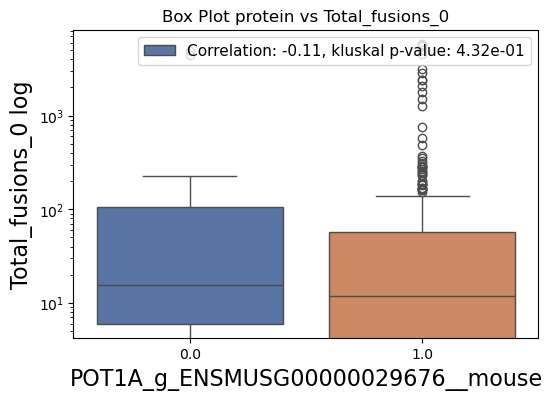

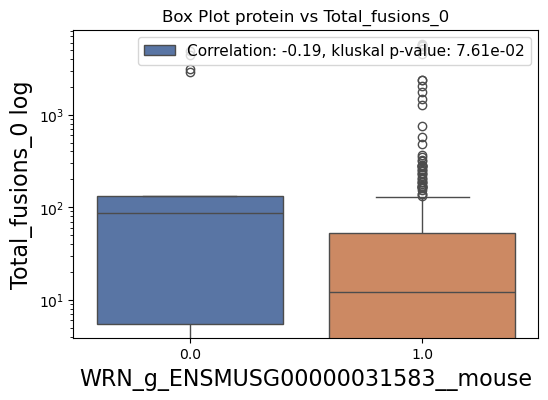

...

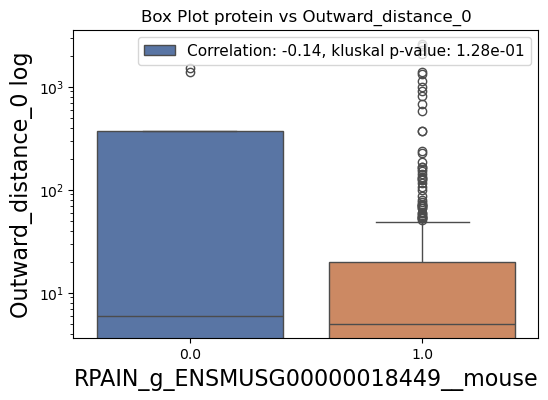

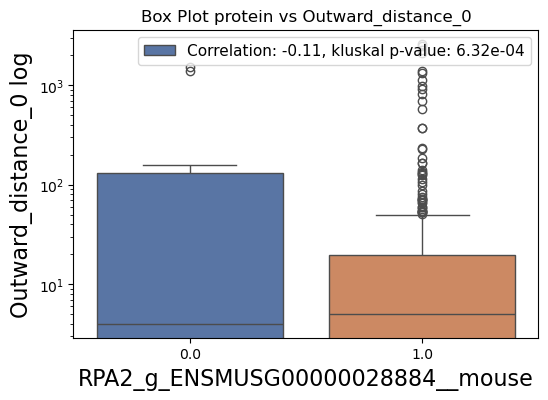

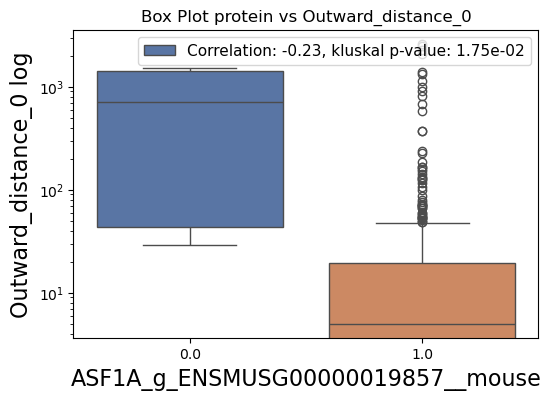

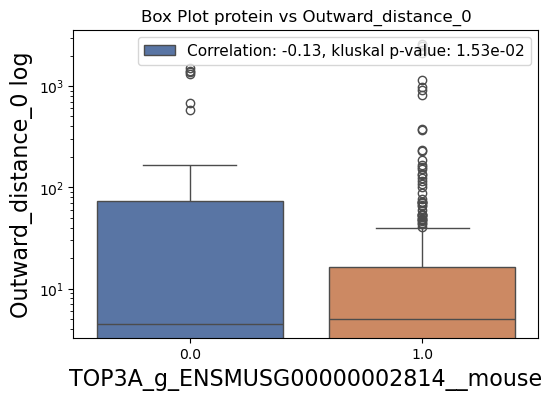

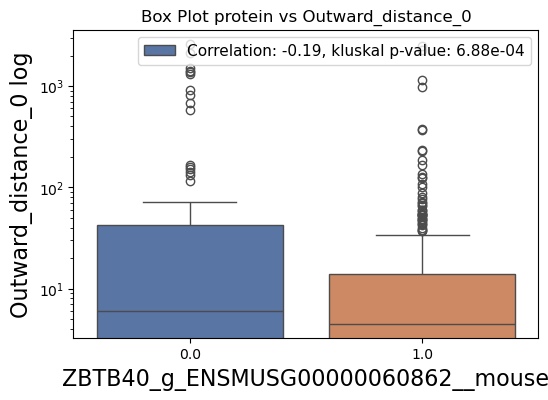

In [102]:

df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df = df.dropna(thresh=df.shape[1] - 2)

# Define columns of interest and load p-values from previous analysis
columns_2 = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']
result_df = pd.read_excel('kruskal_mouse_p_values.xlsx', index_col=0)

# Calculate standard deviations for columns of interest
std_devs = df.filter(like='_g_').std()
valid_columns = std_devs[std_devs > 0].index

# Set correlation threshold for selecting interesting columns
correlation_threshold = 0.10

for column_2 in columns_2:
    # Compute correlations between valid columns and column_2
    correlations = df[valid_columns].corrwith(df[column_2])

    # Select interesting columns based on correlation threshold
    interesting_columns = correlations[abs(correlations) >= correlation_threshold].index
    palette_choice = 'deep'

    for column in interesting_columns:
        
        plt.figure(figsize=(6, 4))
        sns.boxplot(x=column, y=column_2, data=df, hue=column, palette=palette_choice, legend=False)
        
        # Get correlation value
        corr_value = correlations[column]

        # Construct legend labels with correlation value and Kruskal p-value
        legend_labels = []
        if column in result_df.index and column_2 in result_df.columns:
            p_value = result_df.loc[column, column_2]
            legend_labels.append(f'Correlation: {corr_value:.2f}, kluskal p-value: {p_value:.2e}')
        else:
            legend_labels.append(f'Correlation: {corr_value:.2f}')
        
        # set plot
        plt.legend(labels=legend_labels, loc='upper right', fontsize=11)
        plt.title(f'Box Plot protein vs {column_2}')
        plt.xlabel(column, fontsize=16)
        plt.ylabel(column_2 + ' log', fontsize=16)
        plt.yscale('log')
        plt.show()

Human

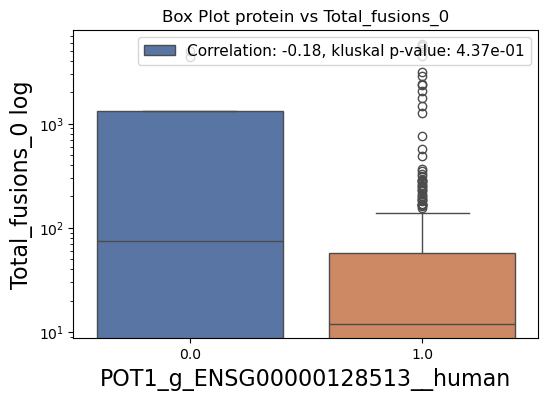

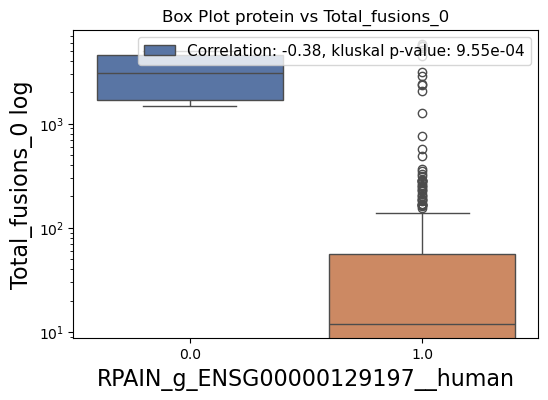

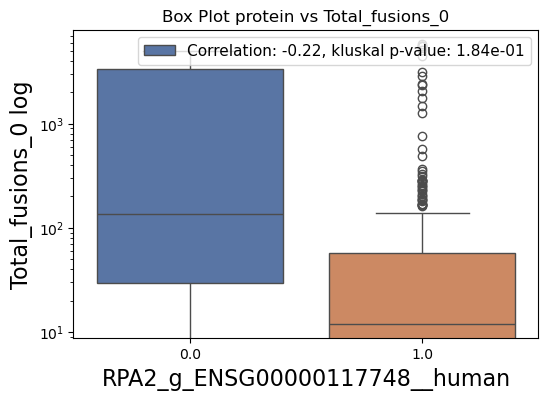

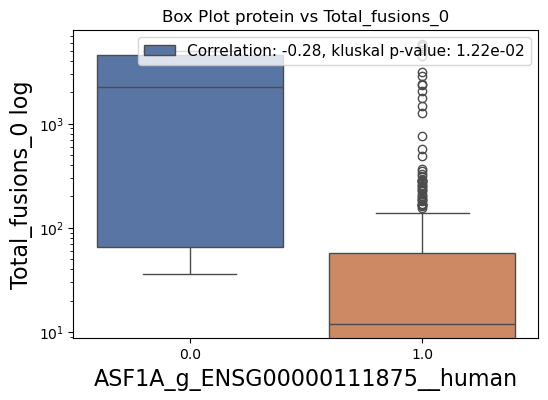

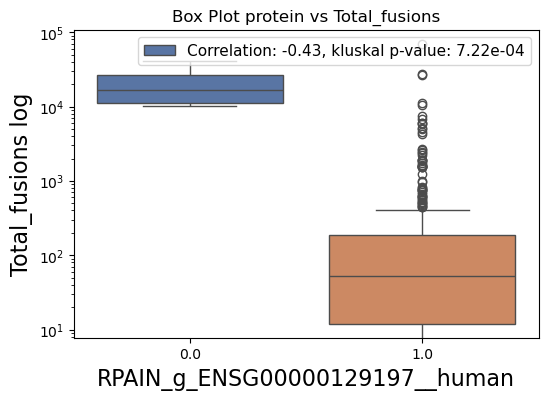

...

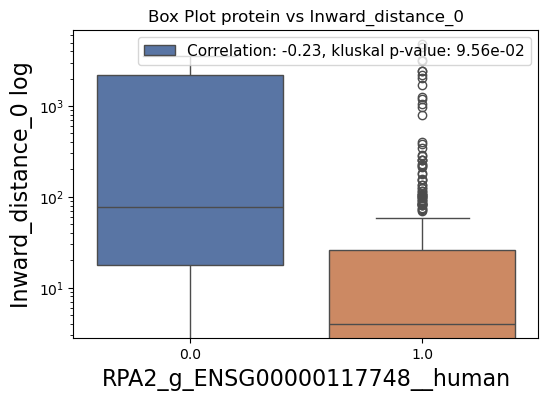

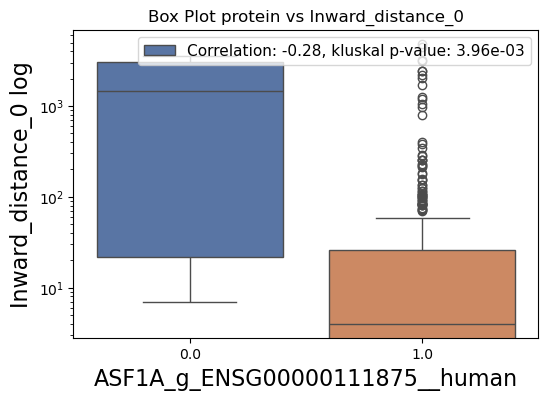

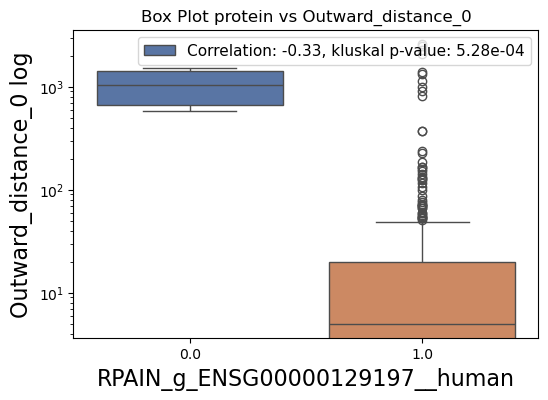

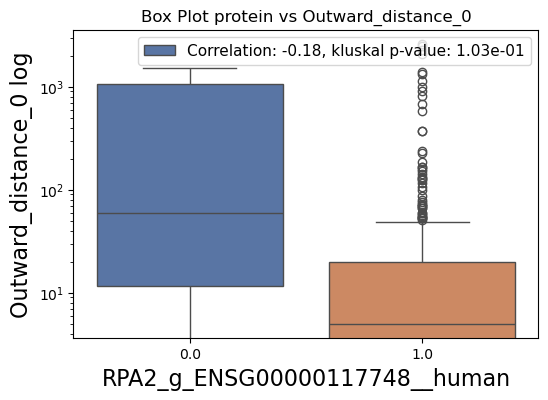

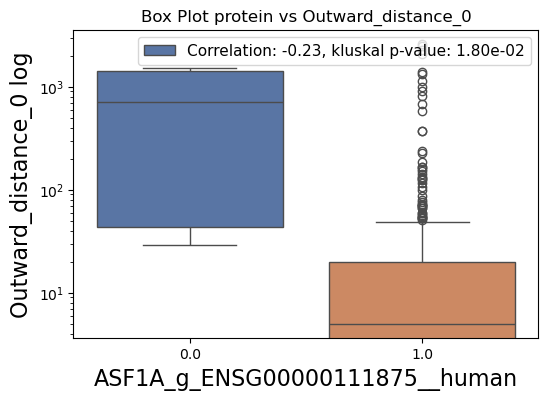

In [100]:
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = df.drop(['CMR', 'ICM'], axis = 1)
columns_interest = df.filter(like='_g_').columns

df = df.dropna(thresh=df.shape[1] - 2)

# Define columns of interest and load p-values from previous analysis
columns_2 = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']
result_df = pd.read_excel('kruskal_mouse_p_values.xlsx', index_col=0)

# Calculate standard deviations for columns of interest
std_devs = df.filter(like='_g_').std()
valid_columns = std_devs[std_devs > 0].index

# Set correlation threshold for selecting interesting columns
correlation_threshold = 0.10

for column_2 in columns_2:
    # Compute correlations between valid columns and column_2
    correlations = df[valid_columns].corrwith(df[column_2])

    # Select interesting columns based on correlation threshold
    interesting_columns = correlations[abs(correlations) >= correlation_threshold].index
    palette_choice = 'deep'

    for column in interesting_columns:
        
        plt.figure(figsize=(6, 4))
        sns.boxplot(x=column, y=column_2, data=df, hue=column, palette=palette_choice, legend=False)
        
        # Get correlation value
        corr_value = correlations[column]

        # Construct legend labels with correlation value and Kruskal p-value
        legend_labels = []
        if column in result_df.index and column_2 in result_df.columns:
            p_value = result_df.loc[column, column_2]
            legend_labels.append(f'Correlation: {corr_value:.2f}, kluskal p-value: {p_value:.2e}')
        else:
            legend_labels.append(f'Correlation: {corr_value:.2f}')
        
        # set plot
        plt.legend(labels=legend_labels, loc='upper right', fontsize=11)
        plt.title(f'Box Plot protein vs {column_2}')
        plt.xlabel(column, fontsize=16)
        plt.ylabel(column_2 + ' log', fontsize=16)
        plt.yscale('log')
        plt.show()


### Showing the P-values of fusion data against proteins

Here we represent the p-values of the correlation against the proteins

Mouse

Total_fusions_0


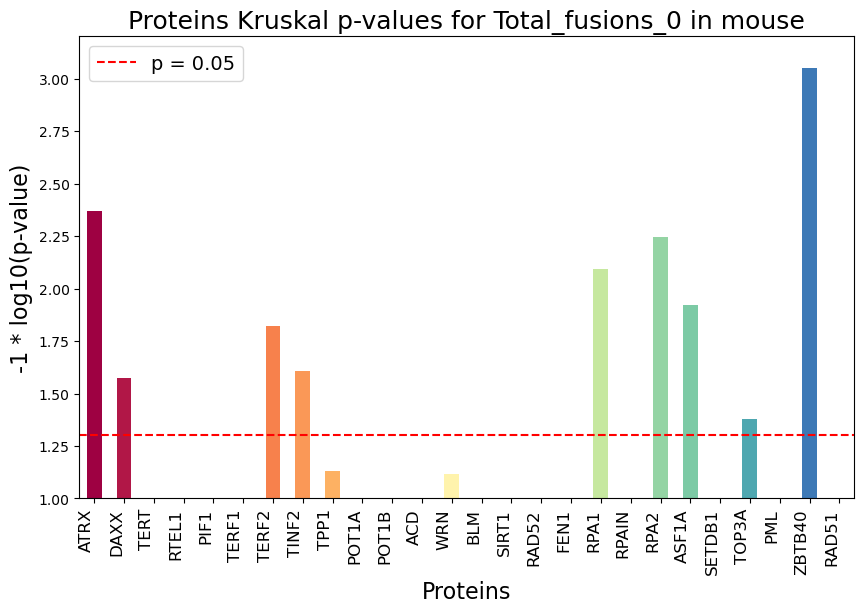

Total_fusions


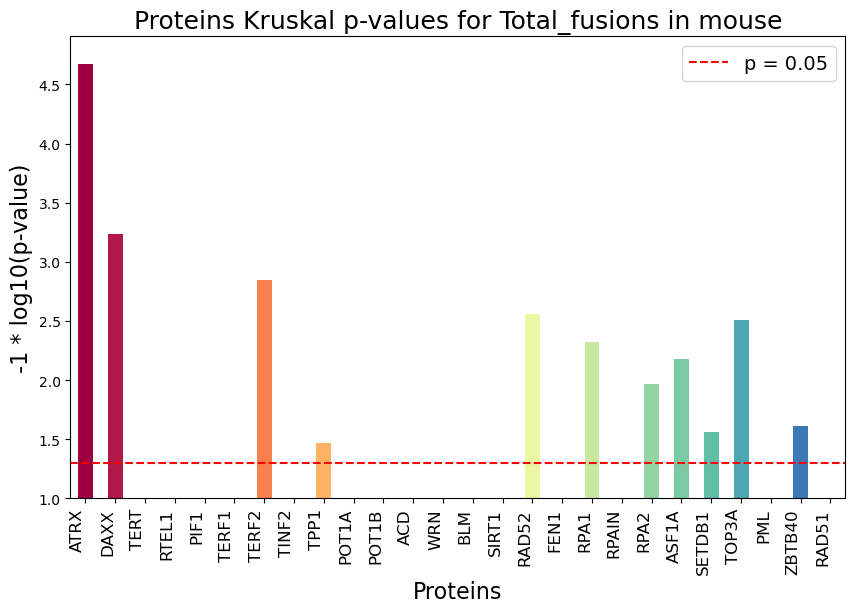

Inward_distance_0


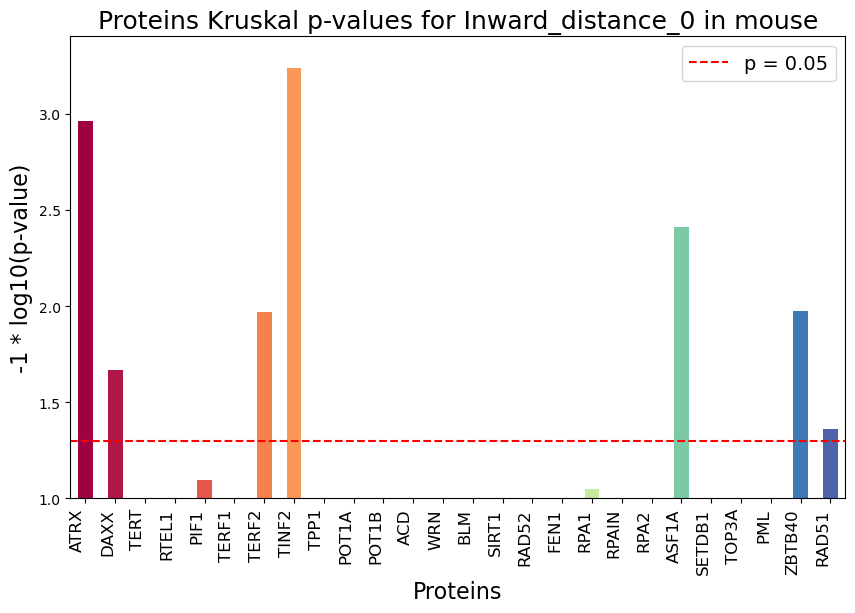

Outward_distance_0


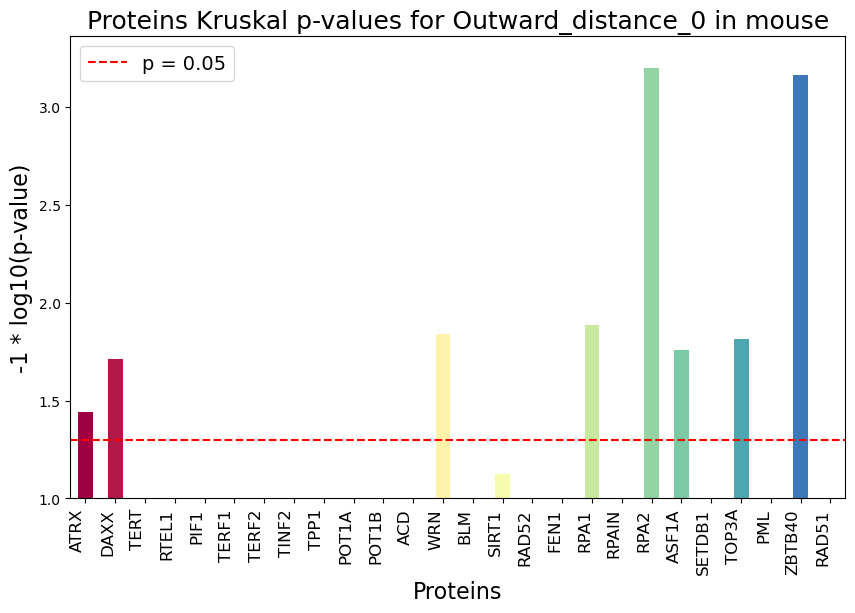

Porcentage_variability


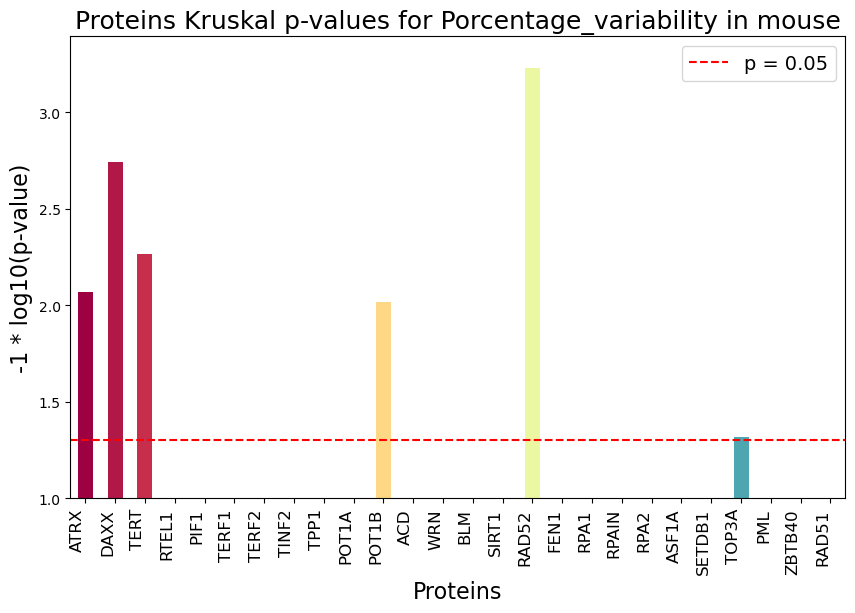

Total_telomere_size


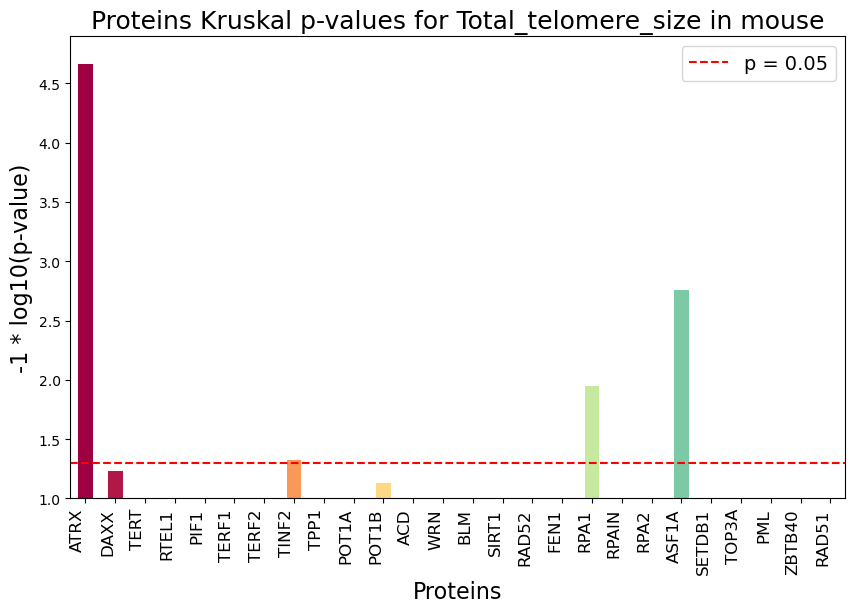

In [107]:
# Read the Kruskal p-values DataFrame and fill NaN values with 1 remove correlations
result_df = pd.read_excel('kruskal_mouse_p_values.xlsx', index_col=0)
result_df = result_df.fillna(1)

# Set significance level for plotting
significance_level = -1 * np.log10(0.05)

# Define a function to get the protein names
def process_protein_name(name):
    return name.split('_')[0]

for column in result_df.columns:

    # Transform p-values to -log10 scale and adjust protein names
    transformed_values = -1 * np.log10(result_df[column])
    transformed_values.index = transformed_values.index.map(process_protein_name)
    
    # Create the bar plot
    plt.figure(figsize=(10, 6))
    transformed_values.plot(kind='bar', color=[colormaps.get_cmap('Spectral')(i / len(transformed_values.index)) for i in range(len(transformed_values.index))])

    # Set plot
    plt.xlabel('Proteins', fontsize=16)
    plt.ylabel('-1 * log10(p-value)', fontsize=16)
    plt.title(f'Proteins Kruskal p-values for {column} in mouse', fontsize=18)
    plt.axhline(y=significance_level, color='red', linestyle='--', label='p = 0.05')  
    plt.xticks(rotation=90, ha='right', fontsize=12)
    plt.ylim(1, plt.ylim()[1])
    plt.legend(['p = 0.05'], fontsize=14)
    plt.show()



Human

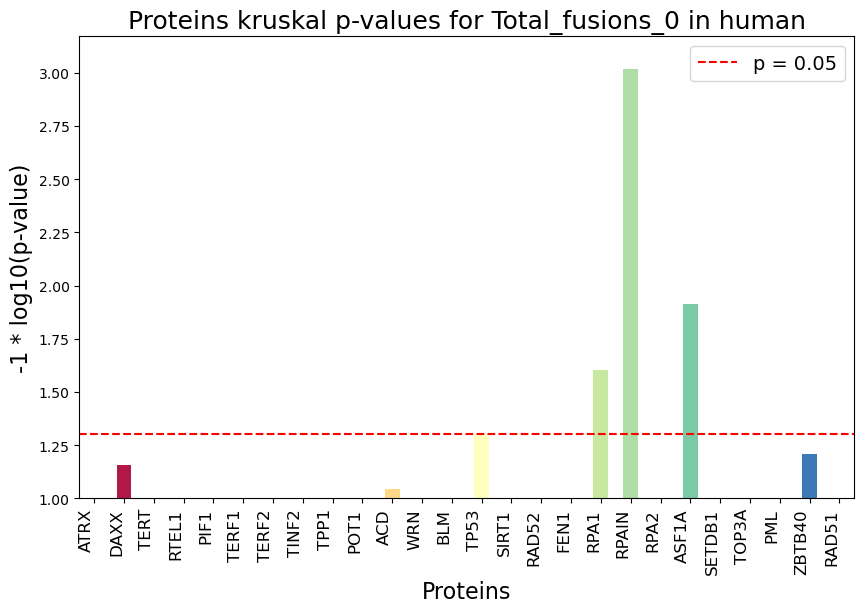

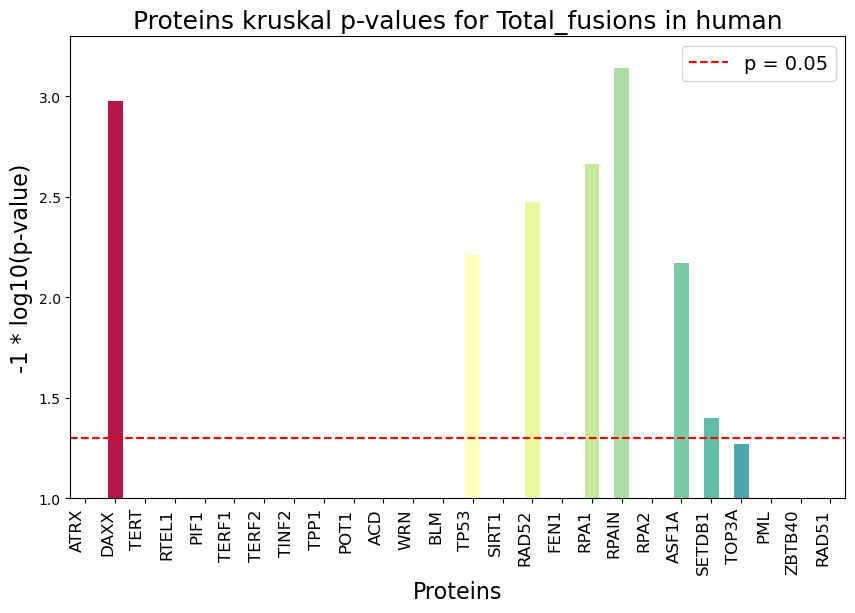

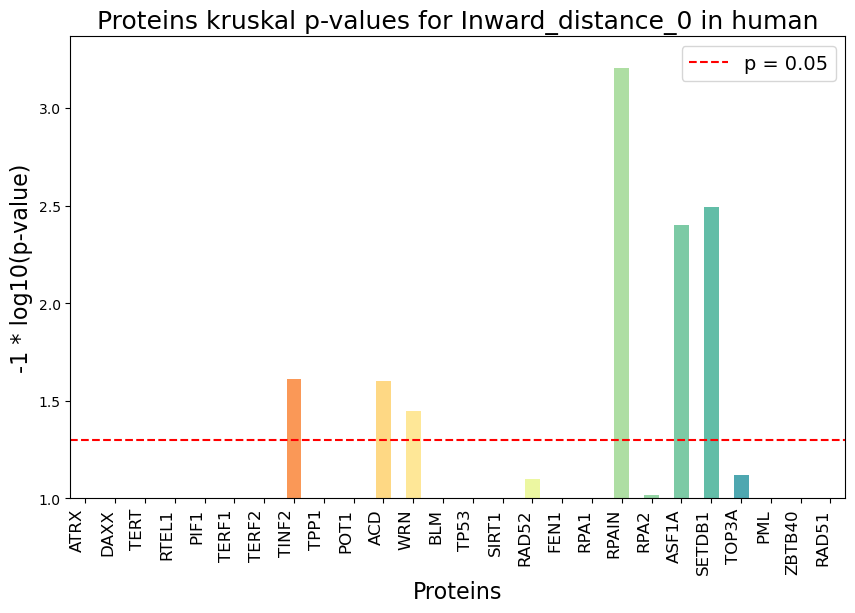

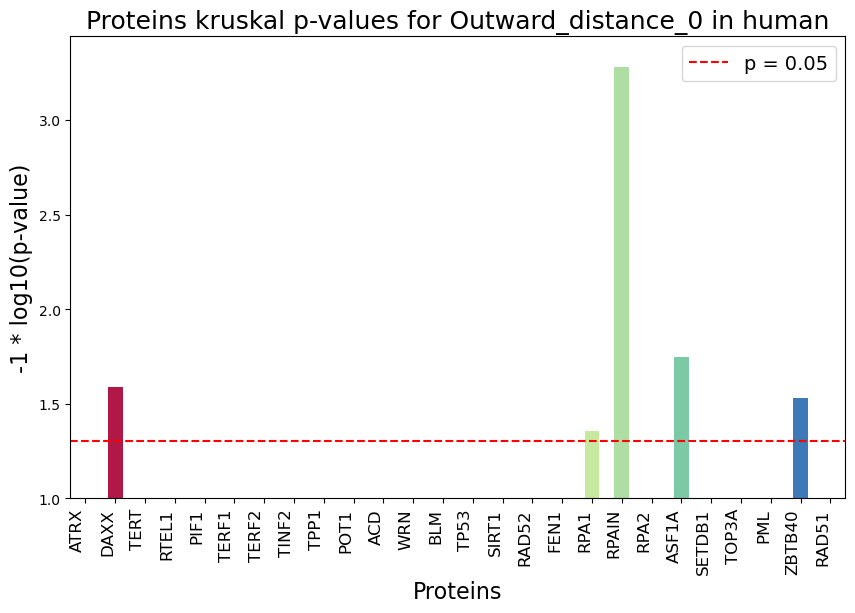

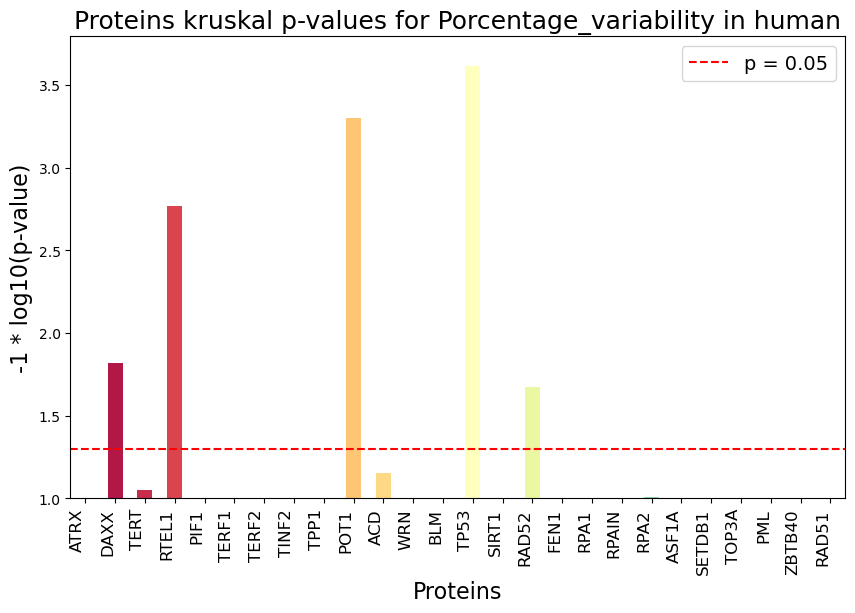

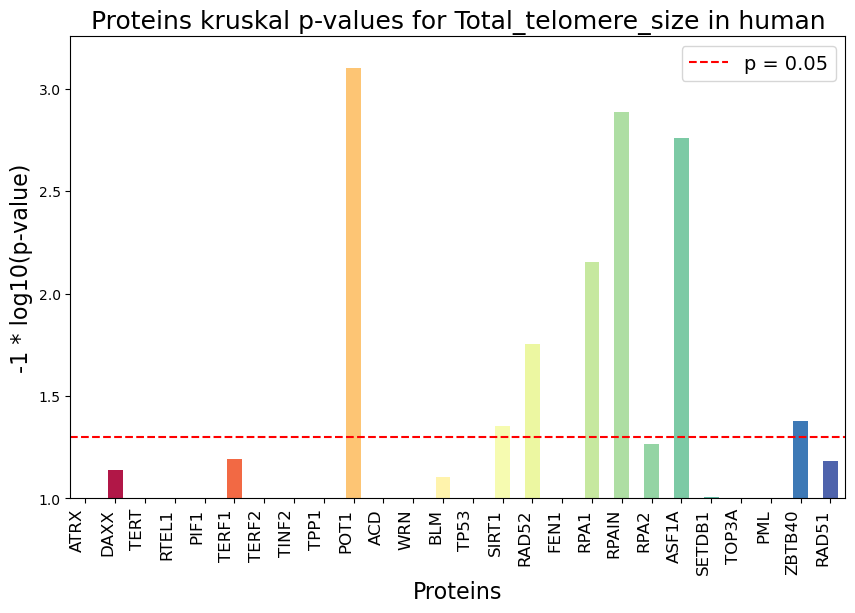

In [106]:
# Read the Kruskal p-values DataFrame and fill NaN values with 1 remove correlations
result_df = pd.read_excel('kruskal_human_p_values.xlsx', index_col=0)
result_df = result_df.fillna(1)

# Set significance level for plotting
significance_level = -1 * np.log10(0.05)

# Define a function to get the protein names
def process_protein_name(name):
    return name.split('_')[0]

for column in result_df.columns:

    # Transform p-values to -log10 scale and adjust protein names
    transformed_values = -1 * np.log10(result_df[column])
    transformed_values.index = transformed_values.index.map(process_protein_name)
    
    # Create the bar plot
    plt.figure(figsize=(10, 6))
    transformed_values.plot(kind='bar', color=[colormaps.get_cmap('Spectral')(i / len(transformed_values.index)) for i in range(len(transformed_values.index))])

    # Set plot
    plt.xlabel('Proteins', fontsize=16)
    plt.ylabel('-1 * log10(p-value)', fontsize=16)
    plt.title(f'Proteins Kruskal p-values for {column} in human', fontsize=18)
    plt.axhline(y=significance_level, color='red', linestyle='--', label='p = 0.05')  
    plt.xticks(rotation=90, ha='right', fontsize=12)
    plt.ylim(1, plt.ylim()[1])
    plt.legend(['p = 0.05'], fontsize=14)
    plt.show()

### Calculating of p-value with diferente categoritation by order

A (absence), U (uncertain) and P (presence)

In [108]:
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df_filtered = df.groupby('Order').filter(lambda x: len(x) >= 5)

protein_columns = df.filter(like='_g_').columns

all_p_values_list = []

grouped_by_order = df_filtered.groupby('Order')

df_t = pd.DataFrame()
df_i = pd.DataFrame()
df_o = pd.DataFrame()
for order, group in grouped_by_order:
    print(f"Analizando Order: {order}")
    
    p_values_t_dict = {}
    p_values_i_dict = {}
    p_values_o_dict = {}
    
    total_fusions_0 = group['Total_fusions_0']
    inward_0 = group['Inward_distance_0']
    outward_0 = group['Outward_distance_0']
    group_t = []
    group_i = []
    group_o = []

    for protein in protein_columns:
        for category in [True, False]:
            data_0 = total_fusions_0[group[protein] == category]
            data_i = inward_0[group[protein] == category]
            data_o = outward_0[group[protein] == category]
            
            if data_0.empty:
                group_t.append([0])
            else:
                group_t.append(data_0)
            if data_i.empty:
                group_i.append([0])
            else:
                group_i.append(data_i)
            if data_o.empty:
                group_o.append([0])
            else:
                group_o.append(data_o)
          
        _, p_value_t = kruskal(*group_t)
        _, p_value_i = kruskal(*group_i)
        _, p_value_o = kruskal(*group_o)
         
        p_values_t_dict[protein] = p_value_t
        p_values_i_dict[protein] = p_value_i
        p_values_o_dict[protein] = p_value_o
    
    order_p_values_df_t = pd.DataFrame.from_dict(p_values_t_dict, orient='index', columns=[f'{order}'])
    order_p_values_df_i = pd.DataFrame.from_dict(p_values_i_dict, orient='index', columns=[f'{order}'])
    order_p_values_df_o = pd.DataFrame.from_dict(p_values_o_dict, orient='index', columns=[f'{order}'])
    df_t = pd.concat([df_t, order_p_values_df_t], axis=1)
    df_i = pd.concat([df_i, order_p_values_df_i], axis=1)
    df_o = pd.concat([df_o, order_p_values_df_o], axis=1)



Analizando Order: Afrosoricida
Analizando Order: Carnivora
Analizando Order: Cetartiodactyla
Analizando Order: Chiroptera
Analizando Order: Eulipotyphla
Analizando Order: Perissodactyla
Analizando Order: Pilosa
Analizando Order: Primates
Analizando Order: Rodentia


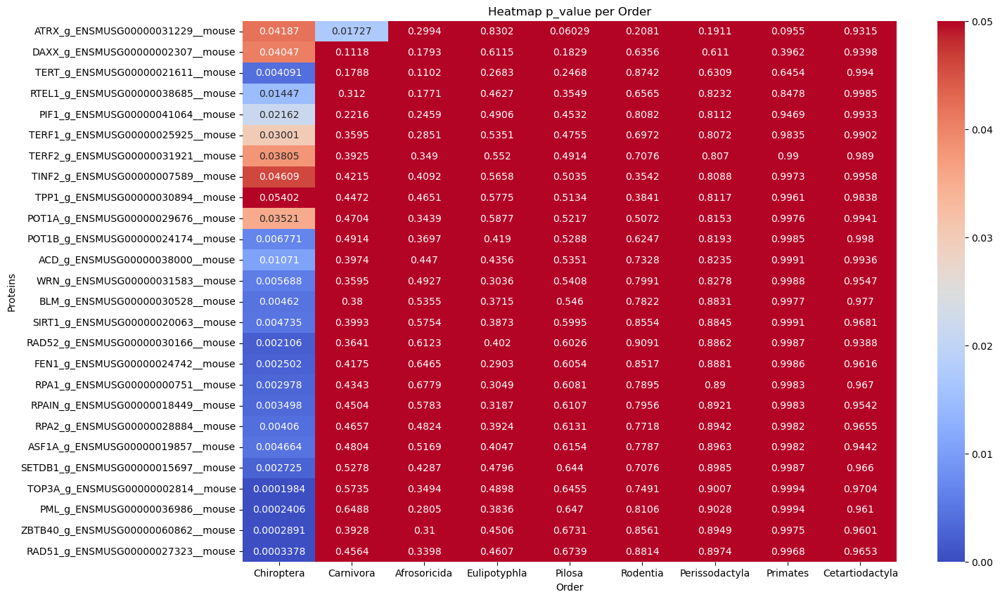

In [109]:
suma_columnas = df_t.sum()
columnas_ordenadas = suma_columnas.sort_values(ascending=True).index
df_t = df_t[columnas_ordenadas]

plt.figure(figsize=(15, 10))
sns.heatmap(df_t, annot=True, cmap='coolwarm', vmin=0, vmax=0.05, fmt=".4g")
plt.title('Heatmap p_value per Order')
plt.xlabel('Order')
plt.ylabel('Proteins')
plt.show()

### Using fusion data from fasta file analysis

We analysed the types of fusions which had distance 0 to determine if there is a type of fusion predominance 

Outward fusions

<Figure size 800x2250 with 0 Axes>

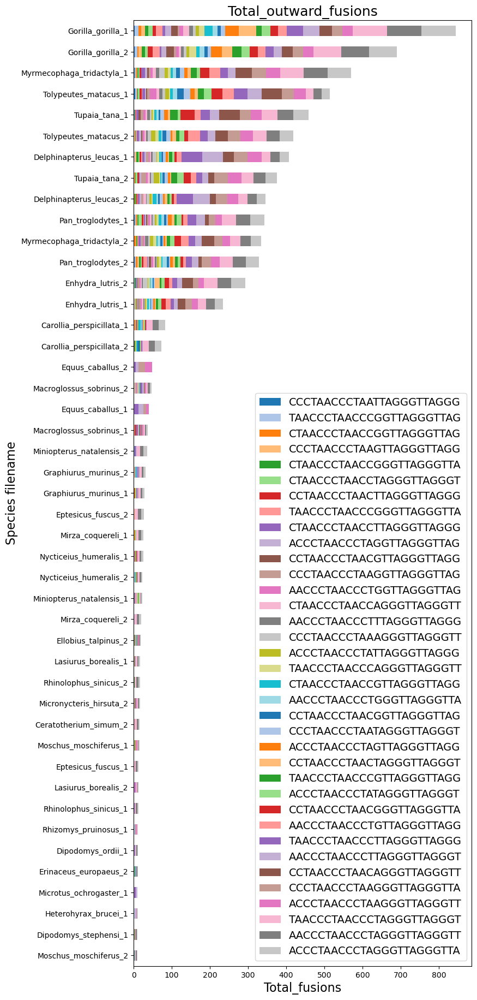

In [119]:
df = pd.read_excel('Final_results_mammals/fusion_frequency_outward.xlsx', index_col=0)

# Extract 'Order' column and remove it
order_column = df['Order']
df = df.drop(columns=['Order'])

# Calculate the sum of fusions for each row
sum_fusions = df.sum(axis=1)

# Filter rows with total fusions count less than 10
df_filtered = df[sum_fusions >= 10]

# Sort rows and columns based on the sum of fusions
df_filtered = df_filtered.loc[sum_fusions[sum_fusions >= 10].sort_values(ascending=True).index]
column_sums = df_filtered.sum(axis=0)
df_filtered = df_filtered[column_sums.sort_values(ascending=True).index]

# Create a bar plot
fig_size = (8, len(df_filtered) * 0.5)
plt.figure(figsize=fig_size)
custom_palette = sns.color_palette('tab20', n_colors=40)
# set plot
df_filtered.plot(kind='barh', stacked=True, figsize=fig_size, color=custom_palette)
plt.ylabel('Species filename', fontsize = 16)
plt.xlabel('Total_fusions', fontsize = 16 )
plt.title('Total_outward_fusions', fontsize = 18)
plt.legend(loc='lower right', fontsize = 14)
plt.show()


Pie chart of fusion breakpoints, This calculates in percentage how much of the fusion represents the total

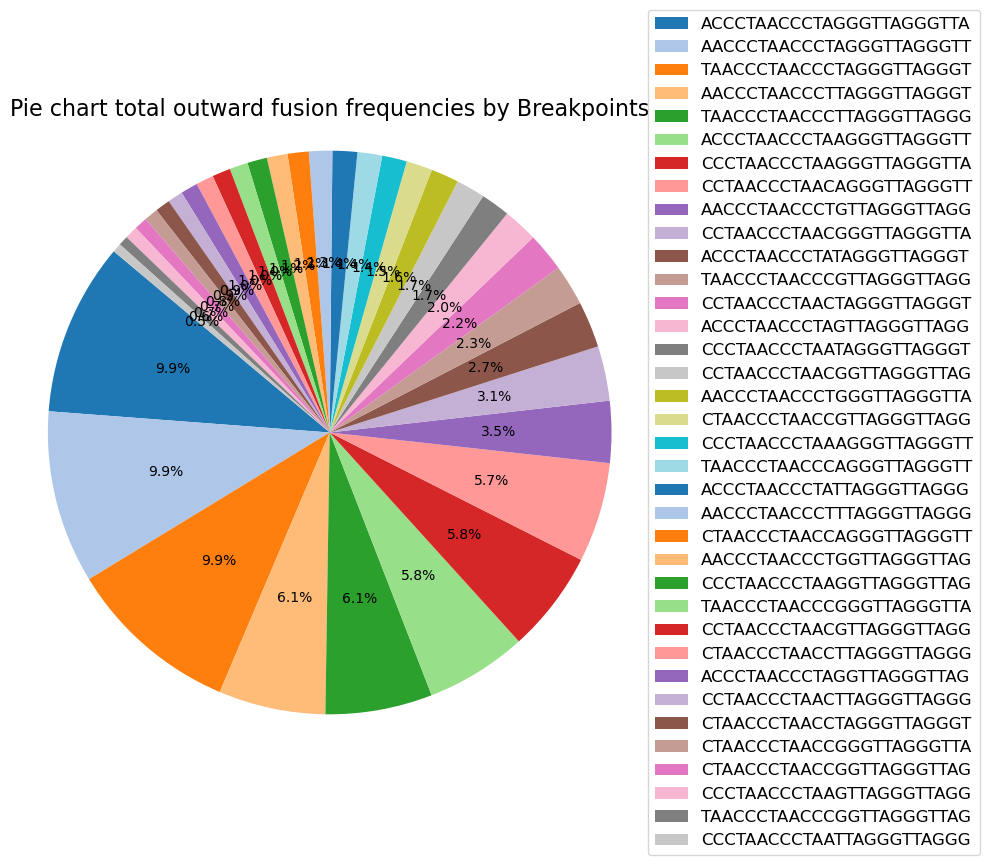

In [123]:
df = pd.read_excel('Final_results_mammals/fusion_frequency_outward.xlsx', index_col=0)
# Drop the 'Order' column from the DataFrame
df = df.drop(columns=['Order'])

# Calculate the sum of each column and sort them in descending order
column_sums = df.sum().sort_values(ascending=False)

# Set pie chart
plt.figure(figsize=(8, 8))

# Create a pie chart with the sums, setting colors and start angle
patches, texts, autotexts = plt.pie(column_sums, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab20.colors)
plt.title('Pie chart total outward fusion frequencies by Breakpoints', fontsize = 16)
legend_labels = [f'{label}' for label, value in zip(column_sums.index, column_sums.values)]
plt.legend(handles=patches, labels=legend_labels, loc="center left", bbox_to_anchor=(1, 0.5), fontsize = 12)
plt.axis('equal')
plt.show()

Inward fusions

<Figure size 800x2500 with 0 Axes>

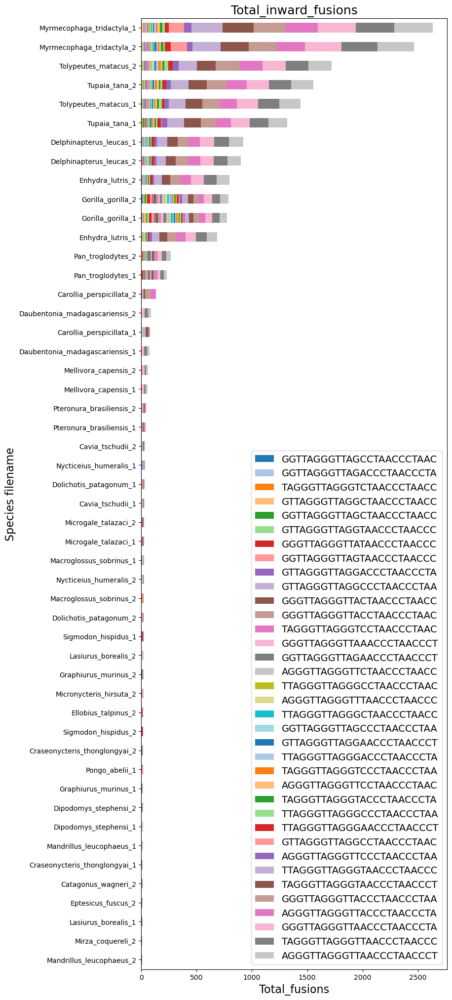

In [117]:

df = pd.read_excel('Final_results_mammals/fusion_frequency_inward.xlsx', index_col=0)
# Extract 'Order' column and remove it
order_column = df['Order']
df = df.drop(columns=['Order'])

# Calculate the sum of fusions for each row
sum_fusions = df.sum(axis=1)

# Filter rows with total fusions count less than 10
df_filtered = df[sum_fusions >= 10]

# Sort rows and columns based on the sum of fusions
df_filtered = df_filtered.loc[sum_fusions[sum_fusions >= 10].sort_values(ascending=True).index]
column_sums = df_filtered.sum(axis=0)
df_filtered = df_filtered[column_sums.sort_values(ascending=True).index]

# Create a bar plot
fig_size = (8, len(df_filtered) * 0.5)
plt.figure(figsize=fig_size)
custom_palette = sns.color_palette('tab20', n_colors=40)
# set plot
df_filtered.plot(kind='barh', stacked=True, figsize=fig_size, color=custom_palette)
plt.ylabel('Species filename', fontsize = 16)
plt.xlabel('Total_fusions', fontsize = 16 )
plt.title('Total_inward_fusions', fontsize = 18)
plt.legend(loc='lower right', fontsize = 14)
plt.show()


Pie chart of fusion breakpoints, This calculates in percentage how much of the fusion represents the total

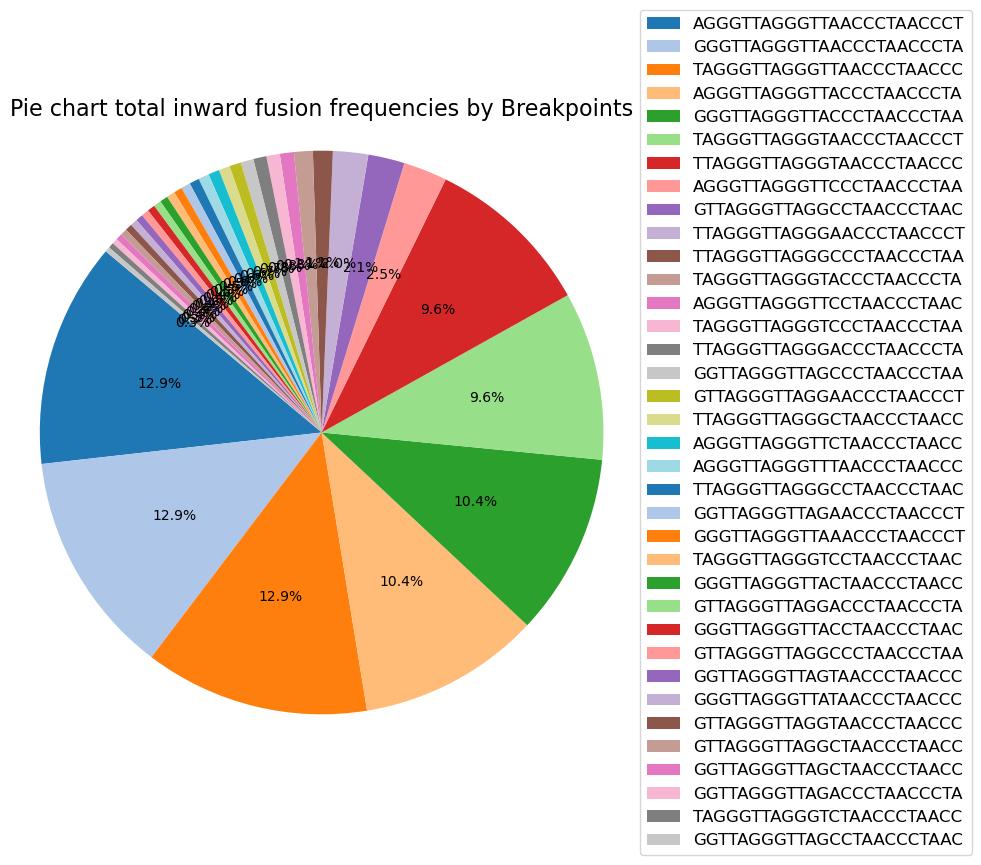

In [124]:

# Leer el DataFrame
df = pd.read_excel('Final_results_mammals/fusion_frequency_inward.xlsx', index_col=0)
# Drop the 'Order' column from the DataFrame
df = df.drop(columns=['Order'])

# Calculate the sum of each column and sort them in descending order
column_sums = df.sum().sort_values(ascending=False)

# Set pie chart
plt.figure(figsize=(8, 8))

# Create a pie chart with the sums, setting colors and start angle
patches, texts, autotexts = plt.pie(column_sums, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab20.colors)
plt.title('Pie chart total inward fusion frequencies by Breakpoints', fontsize = 16)
legend_labels = [f'{label}' for label, value in zip(column_sums.index, column_sums.values)]
plt.legend(handles=patches, labels=legend_labels, loc="center left", bbox_to_anchor=(1, 0.5), fontsize = 12)
plt.axis('equal')
plt.show()

### PCA of fusion breakpoints

In [ ]:
df_fusions = pd.read_excel('Final_results_mammals/fusion_frequency_inward.xlsx')

# Extract 'Order' and 'species' column and remove it from the DataFrame
order_column = df_fusions['Order']
df_fusions = df_fusions.drop(columns=['Order'])
species_columns = df_fusions['Column1']
df_fusions = df_fusions.drop('Column1', axis=1)

# Scale the data
scaler = StandardScaler()
df_fusions_scaled = scaler.fit_transform(df_fusions)

# Impute missing values with the mean
imputer = SimpleImputer(strategy='mean')
df_fusions_imputed = imputer.fit_transform(df_fusions_scaled)
df_fusions_transformed = pd.DataFrame(df_fusions_imputed, columns=df_fusions.columns)

# Perform PCA
pca = PCA()
principal_components = pca.fit_transform(df_fusions_imputed)

# Calculate cumulative explained variance
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

# Extract PCA components and explained variance
components = pca.components_
explained_variance = pca.explained_variance_

# Create DataFrame for PCA components
components_df = pd.DataFrame(components, columns=df_fusions.columns)

# Print sorted component loadings and explained variance for each component
for i, component in enumerate(components_df.iterrows(), start=1):
    print(f"Component {component[0]}:")
    print(component[1].sort_values(ascending=False))
    print(f"Explained Variance: {explained_variance[i - 1]}")
    print()

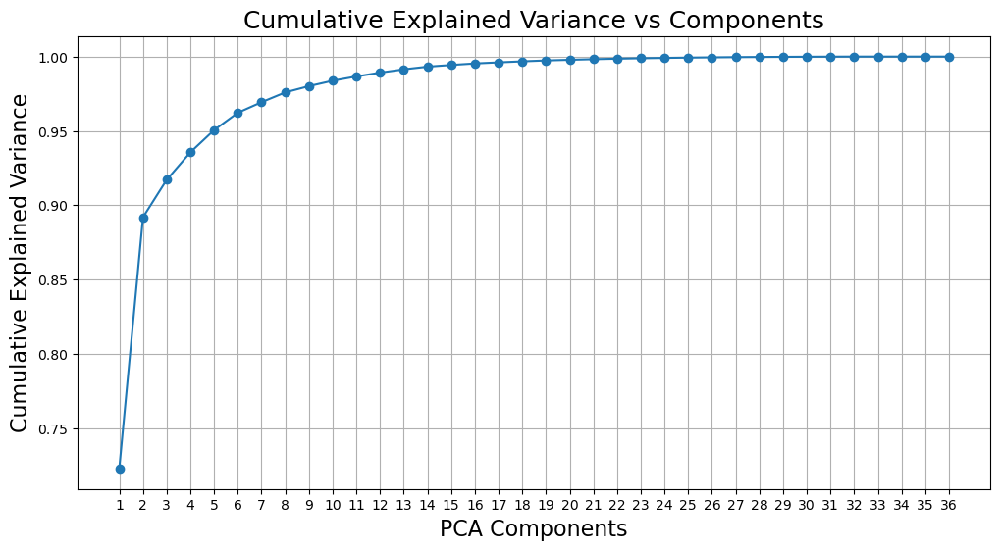

In [129]:
# plot the cumulative explained variance 
plt.figure(figsize=(12, 6))
plt.plot(np.arange(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o', linestyle='-')
plt.title('Cumulative Explained Variance vs Components', fontsize = 18)
plt.xlabel('PCA Components', fontsize = 16)
plt.ylabel('Cumulative Explained Variance', fontsize = 16)
plt.xticks(np.arange(1, len(explained_variance_ratio_cumulative) + 1))
plt.grid(True)
plt.show()

In [6]:
# 3DPlot to see any correlation between components 
df_pca = pd.DataFrame(principal_components[:, :3], columns=['PC1', 'PC2', 'PC3'])
df_pca['Order'] = order_column

fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', color='Order', title='PCA 3D Scatter Plot with Clusters by Order')
fig.show()

In [8]:
# 2DPlot to see any correlation between components 
df_pca_2d = pd.DataFrame(principal_components[:, :2], columns=['PC1', 'PC2'])
df_pca_2d['Order'] = order_column

fig = px.scatter(df_pca_2d, x='PC1', y='PC2', color='Order', title='PCA 2D Scatter Plot with Clusters by Order')
fig.show()

### Random forest proteins vs columns of interest

In order to see differences between proteins and fusions and go further we did a Random forest

Mouse

In [130]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')

# Drop specified columns that have non-numerical variables and we are not interested off
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)

# Drop rows with a significant number of missing values
df = df.dropna(thresh=df.shape[1] - 4)

# Define the columns of interest
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

# List to store feature importance dataframes for mouse
feature_importance_dfs_mouse = []

for column in columns:
    # Fill missing values in the current column with its mean
    column_mean = df[column].mean()
    df[column] = df[column].fillna(column_mean)
    
    # Define target variable y and feature matrix X
    y = df[column]
    X = df.filter(like='_g_')
    
    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Initialize and fit Random Forest Regressor
    rf = RandomForestRegressor(random_state=80)
    rf.fit(X_train, y_train)
    
    # Predict on the test set
    y_pred = rf.predict(X_test)
    
    # Calculate mean squared error and R^2 score
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f'Mean Squared Error for {column}: {mse}')
    print(f'R^2 Score for {column}: {r2}')
    
    # Get feature importances from the model
    feature_importances = rf.feature_importances_
    
    # Create a dataframe for feature importances
    feature_importance_df = pd.DataFrame({
        'feature': X.columns,
        'importance': feature_importances
    })
    
    # Sort feature importances in descending order and keep the top 100
    feature_importance_df.sort_values(by='importance', ascending=False, inplace=True)
    feature_importance_df = feature_importance_df.head(100)
    info_df = pd.DataFrame({
        'feature': [column, 'Mean Squared Error', 'R^2 Score'],
        'importance': [np.nan, mse, r2]
    })
    
    feature_importance_df = pd.concat([info_df, feature_importance_df]).reset_index(drop=True)
    feature_importance_dfs_mouse.append(feature_importance_df)


Mean Squared Error for Total_fusions_0: 1051721.2463278782
R^2 Score for Total_fusions_0: 0.25772670895982985
Mean Squared Error for Total_fusions: 17631966.58487852
R^2 Score for Total_fusions: 0.50841367472314
Mean Squared Error for Inward_distance_0: 321735.20724550803
R^2 Score for Inward_distance_0: 0.3285401326413837
Mean Squared Error for Outward_distance_0: 221877.63432824
R^2 Score for Outward_distance_0: 0.17601353057037283
Mean Squared Error for Porcentage_variability: 0.005676511420047558
R^2 Score for Porcentage_variability: 0.28237167766286075
Mean Squared Error for Chrom_num: 146.56396628086895
R^2 Score for Chrom_num: 0.39303483891464475
Mean Squared Error for Longevity: 105.64676842459417
R^2 Score for Longevity: 0.3647130973526145
Mean Squared Error for Total_telomere_size: 17530572151916.3
R^2 Score for Total_telomere_size: -0.6204182660888067
Mean Squared Error for Porcentage_TTAGGG: 0.005673422346880177
R^2 Score for Porcentage_TTAGGG: 0.28276220033262156


Total_fusions_0


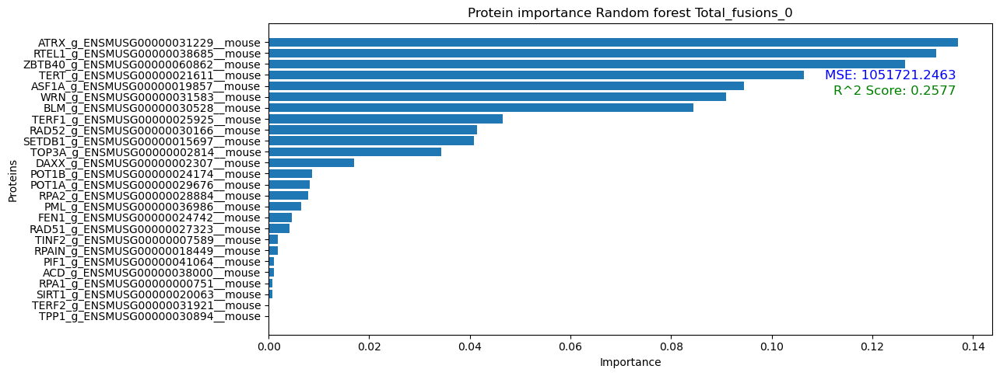

Total_fusions


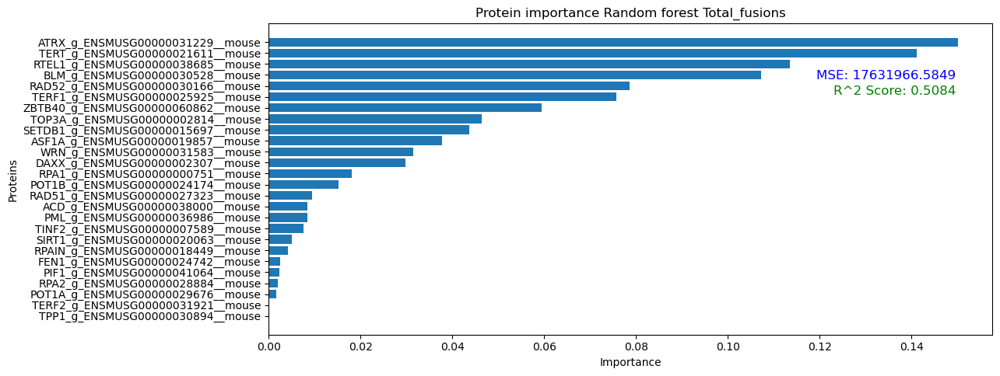

Inward_distance_0


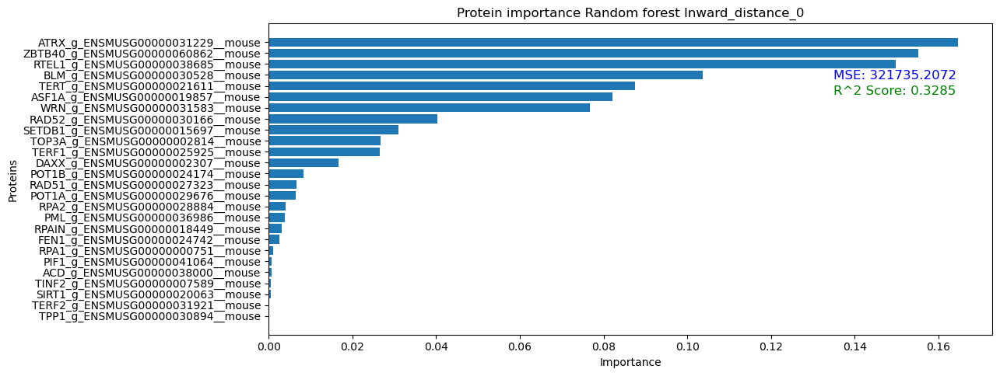

Outward_distance_0


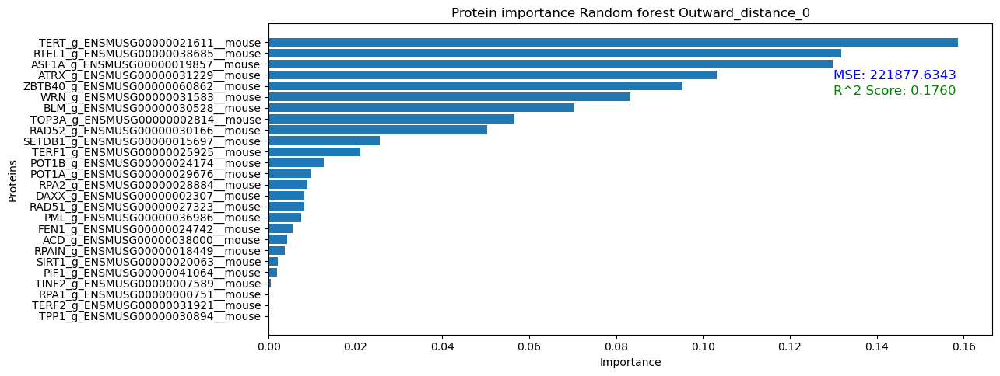

Porcentage_variability


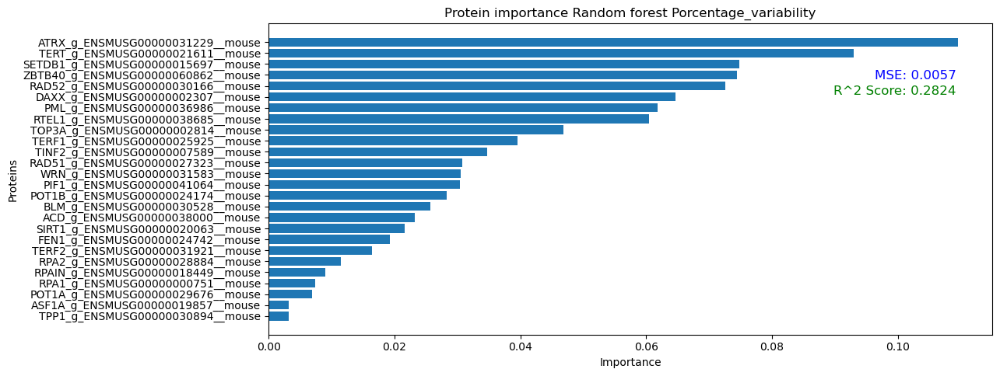

Chrom_num


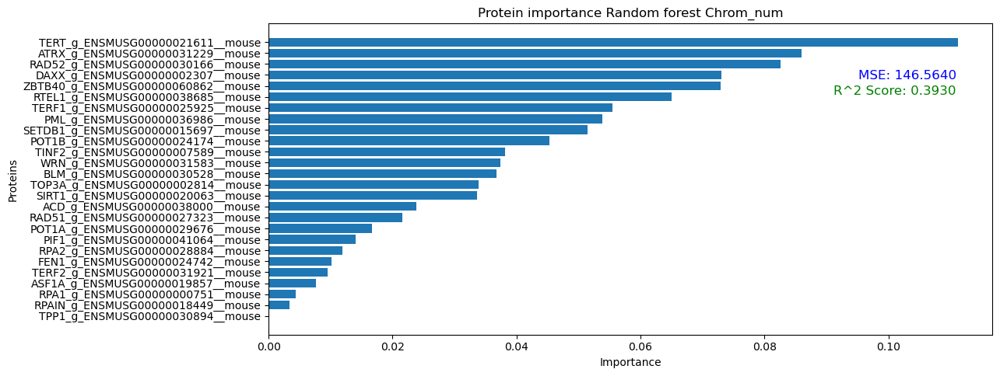

Longevity


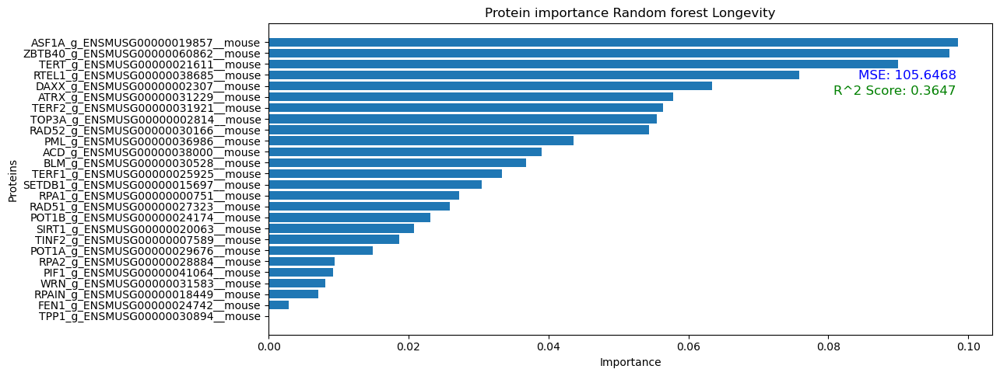

Total_telomere_size


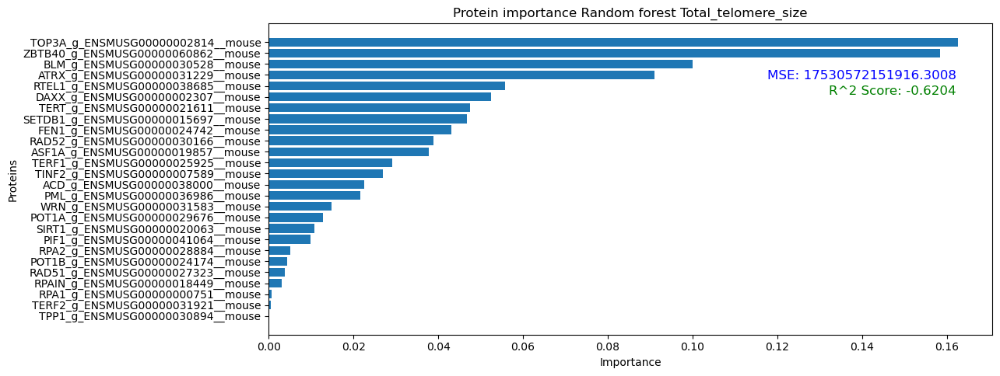

Porcentage_TTAGGG


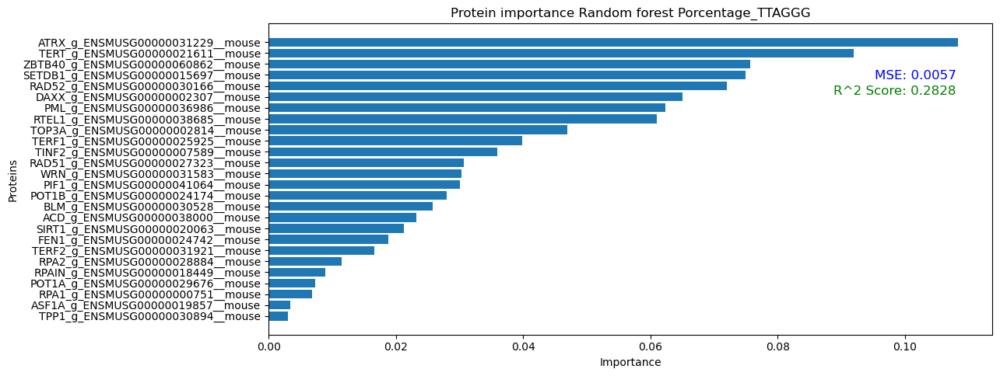

In [131]:
for feature_importance_df in feature_importance_dfs_mouse:
    column_name = feature_importance_df.iloc[0, 0]
    mean_squared_error = feature_importance_df.iloc[1, 1]
    R_Score = feature_importance_df.iloc[2, 1]

    feature_importance_df = feature_importance_df.iloc[3:]
    
    
    feature_importance_df_sorted = feature_importance_df.sort_values(by='importance', ascending=False)
    
    print(column_name)
     
    num_features = len(feature_importance_df_sorted)
    figsize = (12, max(5, num_features / 5))
    plt.figure(figsize=figsize)
    plt.barh(feature_importance_df_sorted['feature'], feature_importance_df_sorted['importance'])
    plt.xlabel('Importance')
    plt.ylabel('Proteins')
    plt.text(0.95, 0.85, f'MSE: {mean_squared_error:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='blue')
    plt.text(0.95, 0.80, f'R^2 Score: {R_Score:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='green')

    plt.title(f'Protein importance Random forest {column_name}')
    plt.gca().invert_yaxis() 
    plt.show()

Human

In [132]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score


df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
# Drop specified columns that have non-numerical variables and we are not interested off
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)

# Drop rows with a significant number of missing values
df = df.dropna(thresh=df.shape[1] - 4)

# Define the columns of interest
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

# List to store feature importance dataframes for mouse
feature_importance_dfs_human = []

for column in columns:
    # Fill missing values in the current column with its mean
    column_mean = df[column].mean()
    df[column] = df[column].fillna(column_mean)
    
    # Define target variable y and feature matrix X
    y = df[column]
    X = df.filter(like='_g_')
    
    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Initialize and fit Random Forest Regressor
    rf = RandomForestRegressor(random_state=80)
    rf.fit(X_train, y_train)
    
    # Predict on the test set
    y_pred = rf.predict(X_test)
    
    # Calculate mean squared error and R^2 score
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f'Mean Squared Error for {column}: {mse}')
    print(f'R^2 Score for {column}: {r2}')
    
    # Get feature importances from the model
    feature_importances = rf.feature_importances_
    
    # Create a dataframe for feature importances
    feature_importance_df = pd.DataFrame({
        'feature': X.columns,
        'importance': feature_importances
    })
    
    # Sort feature importances in descending order and keep the top 100
    feature_importance_df.sort_values(by='importance', ascending=False, inplace=True)
    feature_importance_df = feature_importance_df.head(100)
    info_df = pd.DataFrame({
        'feature': [column, 'Mean Squared Error', 'R^2 Score'],
        'importance': [np.nan, mse, r2]
    })
    
    feature_importance_df = pd.concat([info_df, feature_importance_df]).reset_index(drop=True)
    feature_importance_dfs_human.append(feature_importance_df)

Mean Squared Error for Total_fusions_0: 963477.1124993335
R^2 Score for Total_fusions_0: 0.011372537314414122
Mean Squared Error for Total_fusions: 11553078.53074272
R^2 Score for Total_fusions: 0.08128389505596556
Mean Squared Error for Inward_distance_0: 433974.12657919776
R^2 Score for Inward_distance_0: 0.10461586764307773
Mean Squared Error for Outward_distance_0: 92553.34489478245
R^2 Score for Outward_distance_0: 0.06803679501036042
Mean Squared Error for Porcentage_variability: 0.004459953655634482
R^2 Score for Porcentage_variability: 0.41598250725946284
Mean Squared Error for Chrom_num: 113.9831181670381
R^2 Score for Chrom_num: 0.37295210535827794
Mean Squared Error for Longevity: 234.9870704448527
R^2 Score for Longevity: 0.22833908689683324
Mean Squared Error for Total_telomere_size: 4824061939955.333
R^2 Score for Total_telomere_size: 0.3499935788878642
Mean Squared Error for Porcentage_TTAGGG: 0.004470588838300811
R^2 Score for Porcentage_TTAGGG: 0.4145898621346015


963477.1124993335
Total_fusions_0


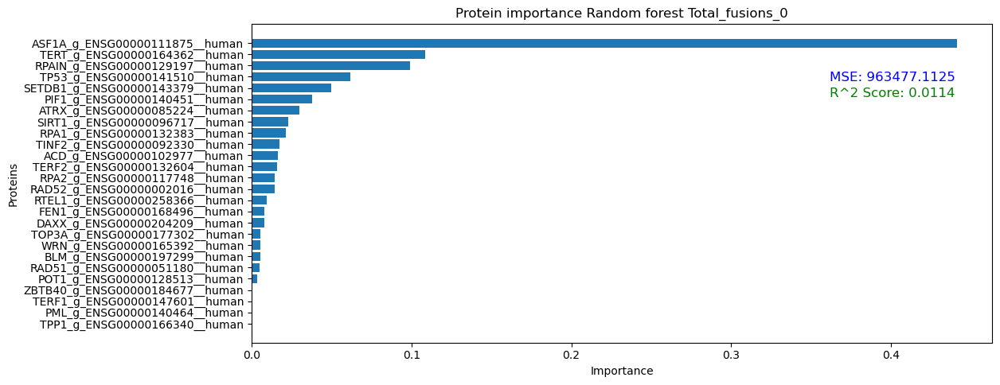

11553078.53074272
Total_fusions


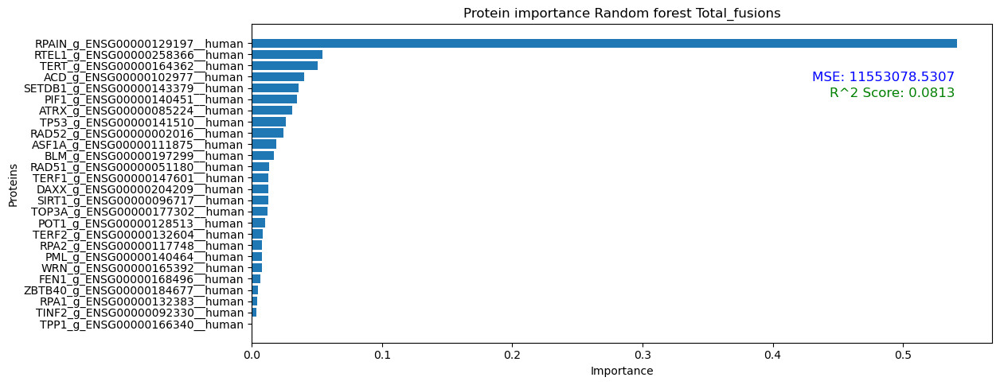

433974.12657919776
Inward_distance_0


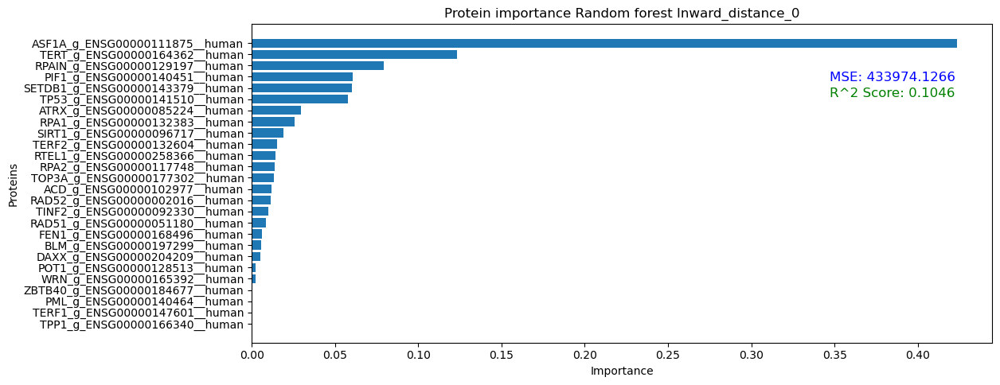

92553.34489478245
Outward_distance_0


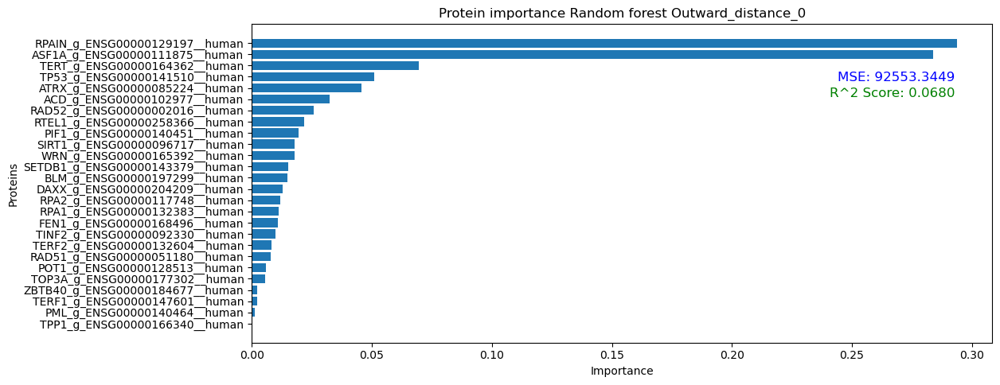

0.004459953655634482
Porcentage_variability


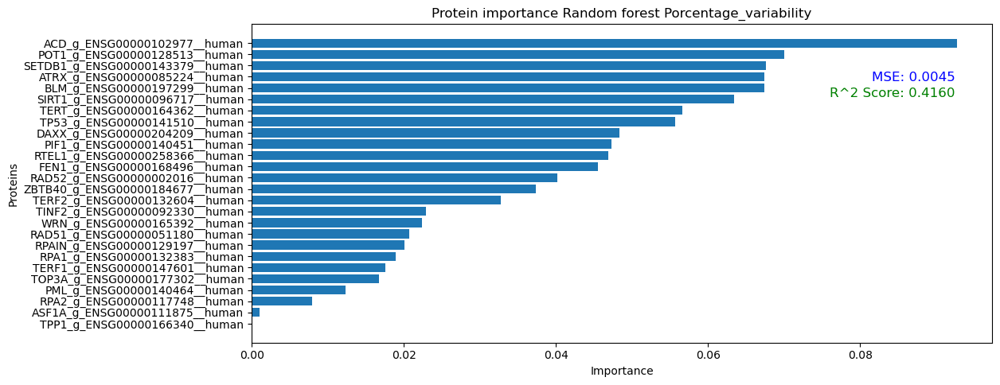

113.9831181670381
Chrom_num


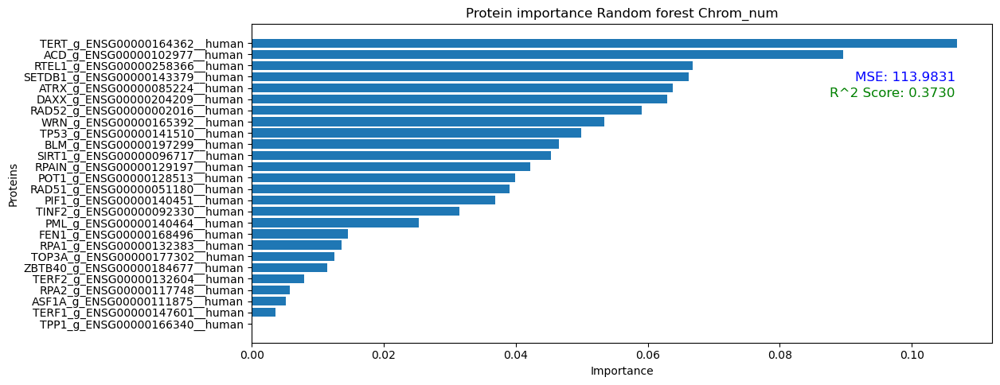

234.9870704448527
Longevity


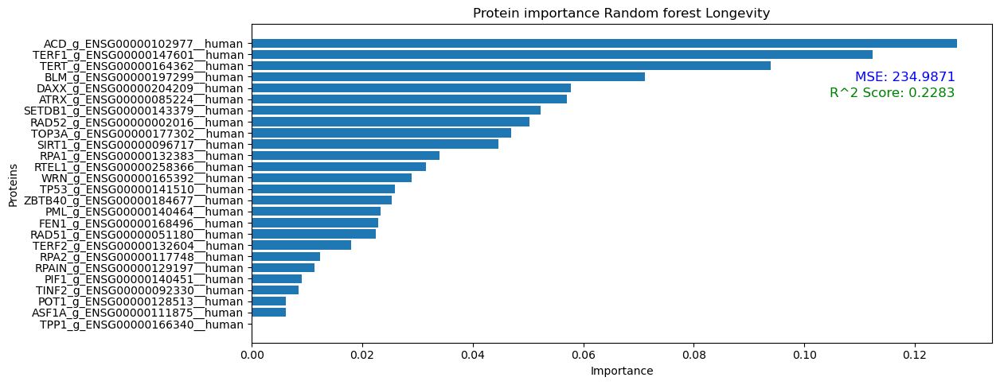

4824061939955.333
Total_telomere_size


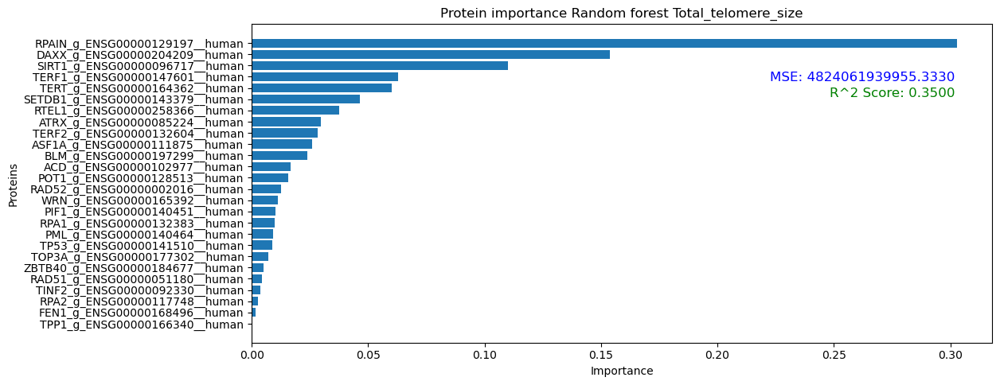

0.004470588838300811
Porcentage_TTAGGG


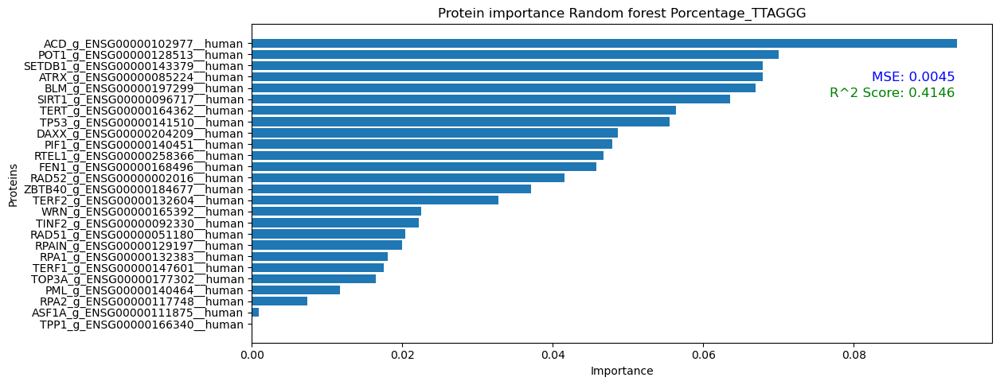

In [133]:
for feature_importance_df in feature_importance_dfs_human:
    column_name = feature_importance_df.iloc[0, 0]
    mean_squared_error = feature_importance_df.iloc[1, 1]
    R_Score = feature_importance_df.iloc[2, 1]
    print(mean_squared_error)
    feature_importance_df = feature_importance_df.iloc[3:]
    
    
    feature_importance_df_sorted = feature_importance_df.sort_values(by='importance', ascending=False)
    
    print(column_name)
     
    num_features = len(feature_importance_df_sorted)
    figsize = (12, max(5, num_features / 5))
    plt.figure(figsize=figsize)
    plt.barh(feature_importance_df_sorted['feature'], feature_importance_df_sorted['importance'])
    plt.xlabel('Importance')
    plt.ylabel('Proteins')
    plt.text(0.95, 0.85, f'MSE: {mean_squared_error:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='blue')
    plt.text(0.95, 0.80, f'R^2 Score: {R_Score:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='green')

    plt.title(f'Protein importance Random forest {column_name}')
    plt.gca().invert_yaxis() 
    plt.show()